#Import

In [46]:
%matplotlib inline
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (8.0, 10.0)

import os
import zipfile
import json

#Functions

In [34]:
def SaveArchive(folder_to_save, where_to_save):
  try:
      os.mkdir(folder_to_save)
  except OSError as error:
      pass
  fantasy_zip = zipfile.ZipFile('{}.zip'.format(where_to_save), 'w')
  for folder, subfolders, files in os.walk(folder_to_save):
    for file in files:
      fantasy_zip.write(os.path.join(folder, file),
                        os.path.relpath(os.path.join(folder, file), folder_to_save),
                        compress_type = zipfile.ZIP_DEFLATED)
  fantasy_zip.close()

def ExtractArchive(filename, where_to_extract):
  try:
      os.mkdir(where_to_extract)
  except OSError as error:
      pass
  with zipfile.ZipFile(filename, 'r') as zip:
    zip.extractall(where_to_extract)

In [35]:
def ApplyFunction(original_folder, function, dir_to_save, dir_for_images):
  for folder, subfolders, files in os.walk(original_folder):
    for file in files:
      function(folder+'/'+file, dir_to_save, dir_for_images)

In [36]:
from pprint import pprint
import PIL

def CropImages(ann_file, dir_to_save, dir_for_images):
  try:
      os.mkdir(dir_to_save)
  except OSError as error:
      pass
  coco = COCO(ann_file)
  for key in coco.anns.keys():
    # print(key)
    # pprint(coco.anns[key])
    img_num = coco.anns[key]['image_id']
    image_filename = coco.imgs[img_num]['file_name']
    #print(dir_for_images, image_filename)
    im = PIL.Image.open("{}/{}".format(dir_for_images, image_filename))
    box = list(map(int, coco.anns[key]['bbox']))
    category_id = coco.anns[key]['category_id']
    new_im = im.crop((box[0], box[1], box[0] + box[2], box[1] + box[3])) # (left, top, right, bottom)
    # new_im.show()
    new_im.save('{}/{}_{}.jpg'.format(dir_to_save, image_filename[:-4], key))
    #break


In [37]:
#test
'''
filename = 'instances_default.json'
CropImages(filename, 'saved', 'imgs')
'''

"\nfilename = 'instances_default.json'\nCropImages(filename, 'saved', 'imgs')\n"

#Pipeline

In [49]:
%cd /content

/content


In [50]:
filename = 'strl_annot.zip'
images = 'strl.zip'
ExtractArchive(filename, 'json_files')
ExtractArchive(images, 'original_images')

In [51]:
ApplyFunction('json_files', CropImages, 'cropped_images', 'original_images')
SaveArchive('cropped_images', 'result')

loading annotations into memory...
Done (t=0.14s)
creating index...
index created!


In [ ]:
# filename = '/content/subsample_annot.zip'
# images = '/content/subsample.zip'
# ExtractArchive(filename, 'json_files')
# ExtractArchive(images, 'original_images')
# ApplyFunction('json_files', CropImages, 'cropped_images', 'original_images/subsample')
# SaveArchive('cropped_images', 'result')


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


# RAM

## imports

In [17]:
# Import dependencies
import ipywidgets as widgets
from IPython.display import clear_output, display, Image
import os

In [18]:
# Clone the repository
!git clone https://github.com/xinyu1205/recognize-anything.git
%cd recognize-anything

Cloning into 'recognize-anything'...
remote: Enumerating objects: 527, done.
remote: Counting objects: 100% (294/294), done.
remote: Compressing objects: 100% (125/125), done.
remote: Total 527 (delta 212), reused 203 (delta 167), pack-reused 233
Receiving objects: 100% (527/527), 23.25 MiB | 16.02 MiB/s, done.
Resolving deltas: 100% (278/278), done.
/content/recognize-anything


In [19]:
# Install dependencies
!pip install timm transformers fairscale pycocoevalcap

clear_output()

In [20]:
def download_checkpoints(model):
    print('You selected', model)
    if not os.path.exists('pretrained'):
        os.makedirs('pretrained')

    if model == "RAM":
        ram_weights_path = 'pretrained/ram_swin_large_14m.pth'
        if not os.path.exists(ram_weights_path):
            !wget https://huggingface.co/spaces/xinyu1205/Recognize_Anything-Tag2Text/resolve/main/ram_swin_large_14m.pth -O pretrained/ram_swin_large_14m.pth
        else:
            print("RAM weights already downloaded!")
    else:
        tag2text_weights_path = 'pretrained/tag2text_swin_14m.pth'
        if not os.path.exists(tag2text_weights_path):
            !wget https://huggingface.co/spaces/xinyu1205/Recognize_Anything-Tag2Text/resolve/main/tag2text_swin_14m.pth -O pretrained/tag2text_swin_14m.pth
        else:
            print("Tag2Text weights already downloaded!")

download_checkpoints('RAM')
download_checkpoints('Tag2Text')

You selected RAM
--2023-07-26 13:34:10--  https://huggingface.co/spaces/xinyu1205/Recognize_Anything-Tag2Text/resolve/main/ram_swin_large_14m.pth
Resolving huggingface.co (huggingface.co)... 65.8.178.27, 65.8.178.118, 65.8.178.93, ...
Connecting to huggingface.co (huggingface.co)|65.8.178.27|:443... connected.
HTTP request sent, awaiting response... 307 Temporary Redirect
Location: /spaces/xinyu1205/recognize-anything/resolve/main/ram_swin_large_14m.pth [following]
--2023-07-26 13:34:10--  https://huggingface.co/spaces/xinyu1205/recognize-anything/resolve/main/ram_swin_large_14m.pth
Reusing existing connection to huggingface.co:443.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.huggingface.co/repos/e6/78/e678f8565485a3f321b1180e4c7e1e18a89a9295028358eedffb98981b37e11a/15c729c793af28b9d107c69f85836a1356d76ea830d4714699fb62e55fcc08ed?response-content-disposition=attachment%3B+filename*%3DUTF-8%27%27ram_swin_large_14m.pth%3B+filename%3D%22ram_swin_large_14m.p

In [21]:
# example
def run_inference(model, task, image_path):
    if model == "Tag2Text" and task == "one image":
        !python inference_tag2text.py  --image {image_path} \
        --pretrained pretrained/tag2text_swin_14m.pth
    elif model == "Tag2Text" and task == "multiple images":
        !python batch_inference.py --image-dir {images_dir} \
        --pretrained pretrained/tag2text_swin_14m.pth --model-type tag2text
    elif model == "RAM" and task == "one image":
        !python inference_ram.py  --image {image_path} \
        --pretrained pretrained/ram_swin_large_14m.pth
    elif model == "RAM" and task == "multiple images":
        !python batch_inference.py --image-dir {images_dir} \
        --pretrained pretrained/ram_swin_large_14m.pth --model-type ram
    else:
        print('Invalid model or task')

## ram

In [22]:
'''
 * The Recognize Anything Model (RAM)
 * Written by Xinyu Huang
'''
import argparse
import numpy as np
import random
import torch
import PIL
from ram.models import ram, tag2text
from ram import inference_ram, inference_tag2text
from ram import get_transform

def get_ram1_model(pretrained='pretrained/ram_swin_large_14m.pth', image_size=384):
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  #######load model
  model = ram(pretrained=pretrained,
              image_size=image_size,
              vit='swin_l')
  model.eval()
  model = model.to(device)
  return model

def get_tag2text1_model(pretrained='pretrained/tag2text_swin_14m.pth', image_size=384, thre=0.68):
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  # delete some tags that may disturb captioning
  # 127: "quarter"; 2961: "back", 3351: "two"; 3265: "three"; 3338: "four"; 3355: "five"; 3359: "one"
  delete_tag_index = [127,2961, 3351, 3265, 3338, 3355, 3359]
  #######load model
  model = tag2text(pretrained=pretrained,
                            image_size=image_size,
                            vit='swin_b',
                            delete_tag_index=delete_tag_index)
  model.threshold = thre  # threshold for tagging
  model.eval()
  model = model.to(device)
  return model

def get_model(model_name):
  if model_name=='RAM':
    model = get_ram1_model()
  elif model_name=='Tag2Text':
    model = get_tag2text1_model()
  return model

def make_inference(model_name, model, image_path, specified_tags='', image_size=384):
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  transform = get_transform(image_size=image_size)
  image = transform(PIL.Image.open(image_path)).unsqueeze(0).to(device)
  if model_name == 'RAM':
    res = inference_ram(image, model)
    #print("Image Tags: ", res[0])
    #print("图像标签: ", res[1])
  elif model_name == 'Tag2Text':
    res = inference_tag2text(image, model, specified_tags)
    #print("Model Identified Tags: ", res[0])
    #print("User Specified Tags: ", res[1])
    #print("Image Caption: ", res[2])
  return res

## inference model

In [52]:
%cd recognize-anything

/content/recognize-anything


In [39]:
class MyCOCO:
    def __init__(self, filepath):
        with open(filepath, 'r') as f:
            self.data = json.loads(f.read())
        self.anns = self.data["annotations"]
        self.imgs = self.data["images"]
        self.cats = self.data["categories"]

    def save(self, filepath):
        with open(filepath, 'w', encoding='utf-8') as f:
            json.dump(self.data, f, indent=4)

In [41]:
from tqdm import tqdm
def get_human_feedback(image_path, text):
  img = PIL.Image.open(image_path)
  plt.imshow(img)
  plt.title(text)
  plt.show()
  print("-----------------")
  human_feedback = input(f"{text}\nEvaluate text quality [-1, 0, 1]: ")
  if not human_feedback:
    human_feedback = -1
  else:
    human_feedback = int(human_feedback)
  return human_feedback


def ApplyModel(model_name, ann_file, images_dir, output, starting_index=0, hf=False):
  if model_name not in ['RAM', 'Tag2Text']:
    raise NotImplementedError
  model = get_model(model_name)
  print('model is ready!')

  # copy folder to another directory
  # images_dir = "images/my_images"
  # !cp image_folder 'recognize_anything/{}'.format(images_dir)
  #image_files = [f"{images_dir}/{file}" for file in sorted(os.listdir(images_dir)) if file.lower().endswith(('.jpg', '.jpeg', '.png'))]
  coco = MyCOCO(ann_file)
  n = len(coco.anns)
  print(n)
  for i in tqdm(range(starting_index, n)):
    # print(key)
    # pprint(coco.anns[key])
    img_num = coco.anns[i]['image_id']
    image_path = '{}/{}_{}.jpg'.format(images_dir, coco.imgs[img_num - 1]['file_name'][:-4], i + 1)
    # print('image_path is ', image_path)
    category_id = coco.anns[i]['category_id']
    category = coco.cats[category_id - 1]['name']
    # print(category)
    # print(f"Progress: {i}/{n}")
    # Run Inference
    result = make_inference(model_name, model, image_path, specified_tags='')
    # print('result is', result)
    # print("success!")
    # break
    # save to coco?
    if model_name == 'RAM':
      tags = result[0]
      coco.anns[i]['ram'] = tags
    elif model_name == 'Tag2Text':
      text = result[2]
      coco.anns[i]['tag2text_text'] = text
      if hf:
        coco.anns[i]['tag2text_text_hf'] = get_human_feedback(image_path, f"{category}: {text}")
      result = make_inference(model_name, model, image_path, specified_tags=category)
      text = result[2]
      coco.anns[i]['tag2text_text_with_class'] = text
      if hf:
        coco.anns[i]['tag2text_text_with_class_hf'] = get_human_feedback(image_path, f"{category}: {text}")

  coco.save(output)


In [42]:
# # get images
# annotation = 'strl_annot'
# original_images = 'strl'

# filename = '/content/{}.zip'.format(annotation)
# images = '/content/{}.zip'.format(original_images)
# ExtractArchive(filename, 'json_files')
# ExtractArchive(images, 'original_images')
# ApplyFunction('json_files', CropImages, 'cropped_images',
#               '/content/recognize-anything/original_images/{}'.format(original_images))

In [43]:
# # test
# run_inference('RAM', 'one image', 'images/demo/demo1.jpg')#'cropped_images/frame0031_zednode_1.jpg'

In [100]:
# for starting annotation
ann_file = '/content/json_files/annotations/instances_default.json'
output_file = 'annot_and_t2t.json'
ApplyModel('Tag2Text', ann_file, '/content/cropped_images', output_file)

/encoder/layer/0/crossattention/self/query is tied
/encoder/layer/0/crossattention/self/key is tied
/encoder/layer/0/crossattention/self/value is tied
/encoder/layer/0/crossattention/output/dense is tied
/encoder/layer/0/crossattention/output/LayerNorm is tied
/encoder/layer/0/intermediate/dense is tied
/encoder/layer/0/output/dense is tied
/encoder/layer/0/output/LayerNorm is tied
/encoder/layer/1/crossattention/self/query is tied
/encoder/layer/1/crossattention/self/key is tied
/encoder/layer/1/crossattention/self/value is tied
/encoder/layer/1/crossattention/output/dense is tied
/encoder/layer/1/crossattention/output/LayerNorm is tied
/encoder/layer/1/intermediate/dense is tied
/encoder/layer/1/output/dense is tied
/encoder/layer/1/output/LayerNorm is tied
--------------
pretrained/tag2text_swin_14m.pth
--------------
load checkpoint from pretrained/tag2text_swin_14m.pth
vit: swin_b
model is ready!
1402


100%|██████████| 1402/1402 [30:55<00:00,  1.32s/it]


In [44]:
with open("/content/labels_to_include.txt", 'r') as f:
  labels_to_include = [label.strip() for label in f.readlines()]

def add_human_feedback(coco_annotations, images_dir, tags, output, starting_index=0):
    coco = MyCOCO(coco_annotations)
    n = len(coco.anns)
    for i in range(starting_index, n):
        img_num = coco.anns[i]['image_id']
        image_path = '{}/{}_{}.jpg'.format(images_dir, coco.imgs[img_num - 1]['file_name'][:-4], i + 1)
        category_id = coco.anns[i]['category_id']
        category = coco.cats[category_id - 1]['name']

        if category not in labels_to_include:
            continue

        print(f"Progress {i}/{n}")

        for tag in tags:
            text = coco.anns[i][tag]
            hf = get_human_feedback(image_path, f"{category}: {text}")
            coco.anns[i][f"{tag}_hf"] = hf
        coco.save(output)


In [ ]:
# fix the broken
coco_fix = MyCOCO("/content/recognize-anything/annot_and_t2t.json")

with open("/content/backup.json") as f:
    backup_data = json.loads(f.read())

for key, obj in backup_data.items():
    index = int(key)
    for tag in obj.keys():
        coco_fix.anns[index][tag] = backup_data[key][tag]
coco_fix.anns[:10]

In [31]:
coco_fix.save("/content/recognize-anything/annot_and_t2t_965.json")

In [ ]:
coco_annots = "/content/recognize-anything/annot_and_t2t.json"
images_dir = "/content/cropped_images"
tags = [
    "tag2text_text",
    "tag2text_text_with_class"
]
output = "annot_t2t_hf.json"

add_human_feedback(coco_annots, images_dir, tags, output, starting_index=0)

Progress 976/1402


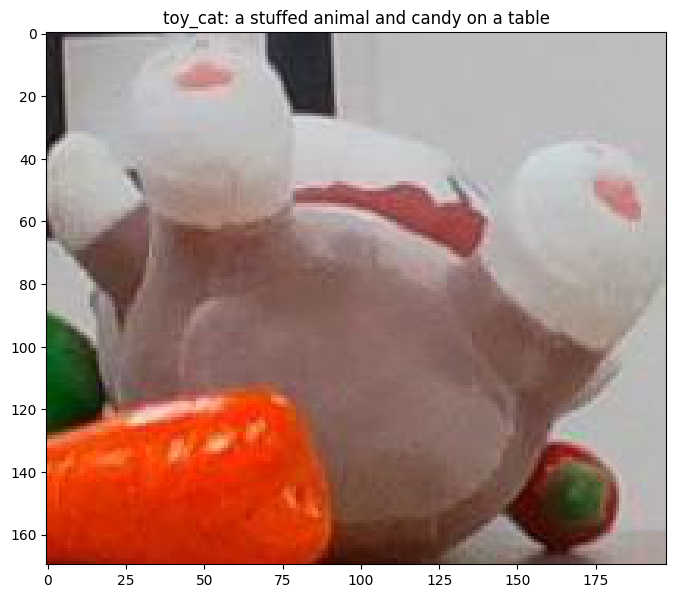

toy_cat: a stuffed animal and candy on a table
Evaluate text quality [-1, 0, 1]: 0


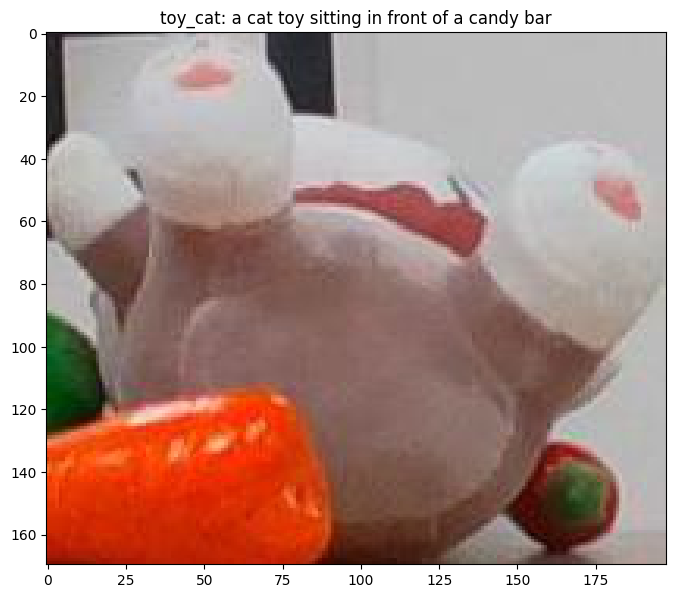

toy_cat: a cat toy sitting in front of a candy bar
Evaluate text quality [-1, 0, 1]: 0
Progress 978/1402


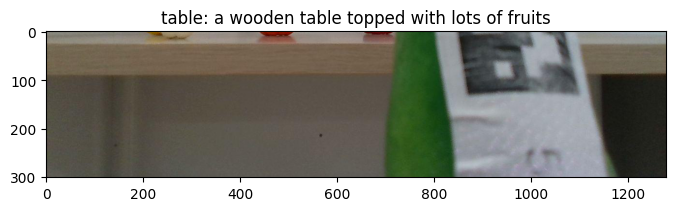

table: a wooden table topped with lots of fruits
Evaluate text quality [-1, 0, 1]: 


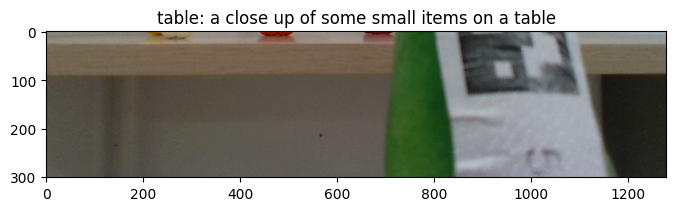

table: a close up of some small items on a table
Evaluate text quality [-1, 0, 1]: 1
Progress 979/1402


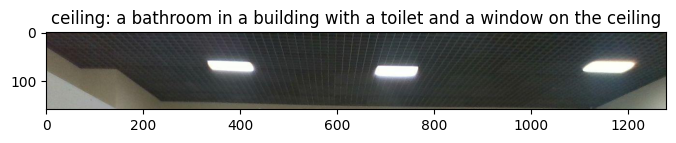

ceiling: a bathroom in a building with a toilet and a window on the ceiling
Evaluate text quality [-1, 0, 1]: 


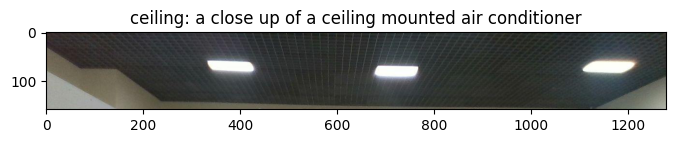

ceiling: a close up of a ceiling mounted air conditioner
Evaluate text quality [-1, 0, 1]: 
Progress 985/1402


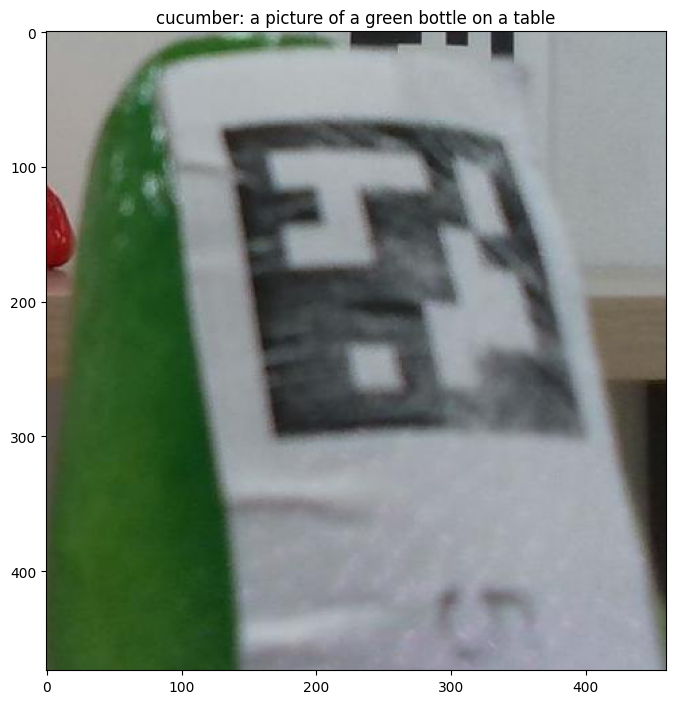

cucumber: a picture of a green bottle on a table
Evaluate text quality [-1, 0, 1]: 


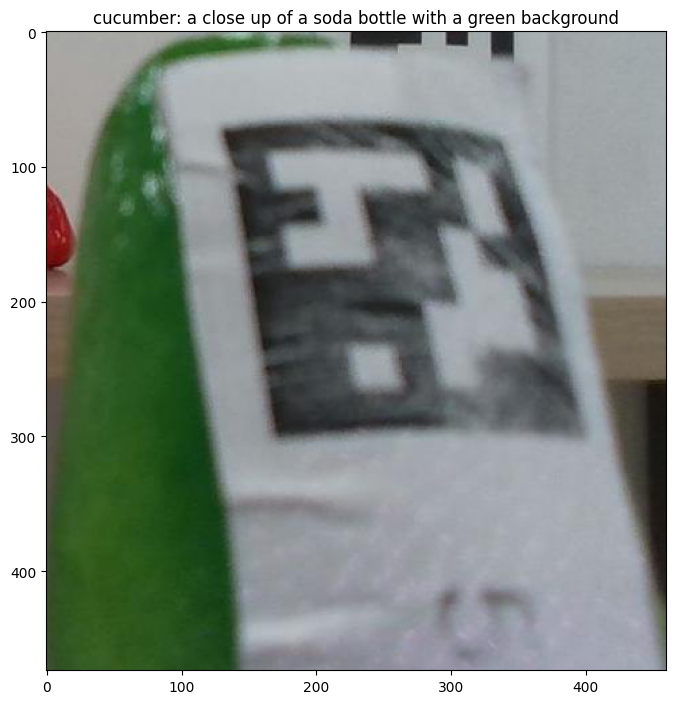

cucumber: a close up of a soda bottle with a green background
Evaluate text quality [-1, 0, 1]: 
Progress 993/1402


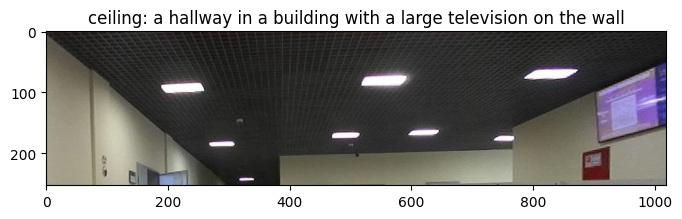

ceiling: a hallway in a building with a large television on the wall
Evaluate text quality [-1, 0, 1]: 


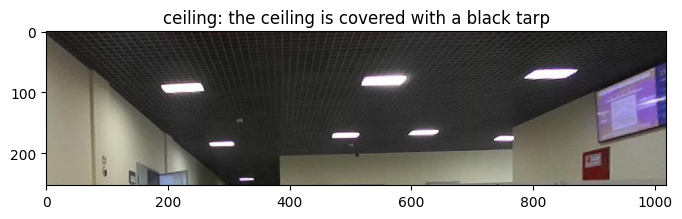

ceiling: the ceiling is covered with a black tarp
Evaluate text quality [-1, 0, 1]: 0
Progress 1006/1402


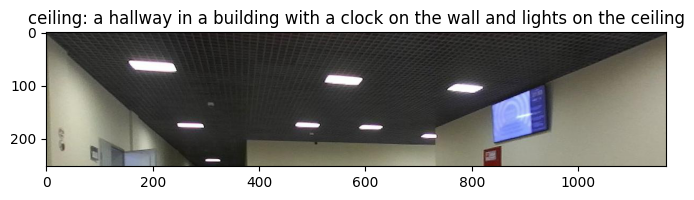

ceiling: a hallway in a building with a clock on the wall and lights on the ceiling
Evaluate text quality [-1, 0, 1]: 


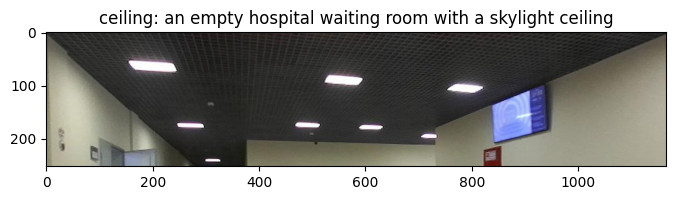

ceiling: an empty hospital waiting room with a skylight ceiling
Evaluate text quality [-1, 0, 1]: 
Progress 1018/1402


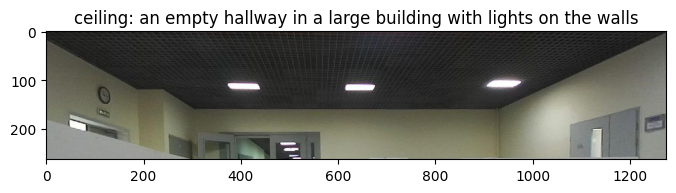

ceiling: an empty hallway in a large building with lights on the walls
Evaluate text quality [-1, 0, 1]: 


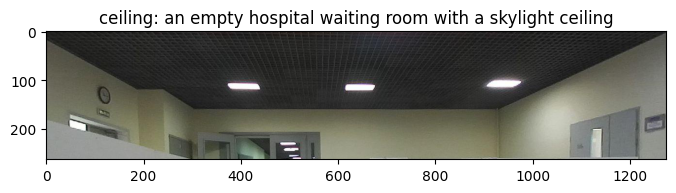

ceiling: an empty hospital waiting room with a skylight ceiling
Evaluate text quality [-1, 0, 1]: 
Progress 1032/1402


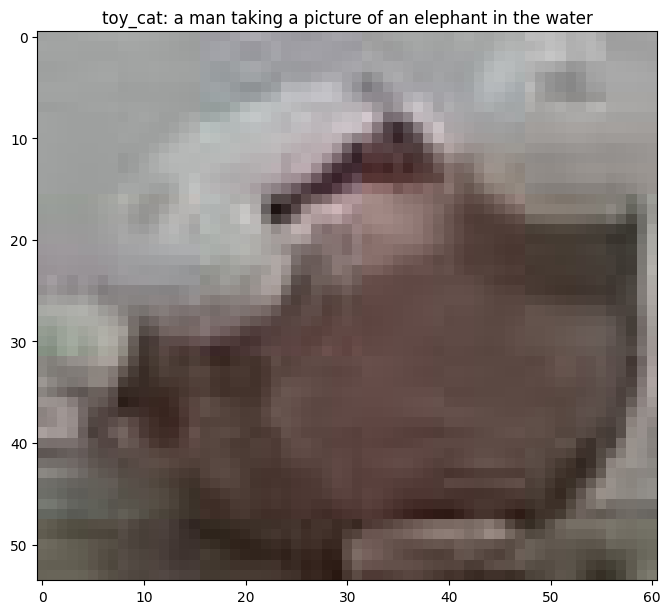

toy_cat: a man taking a picture of an elephant in the water
Evaluate text quality [-1, 0, 1]: 


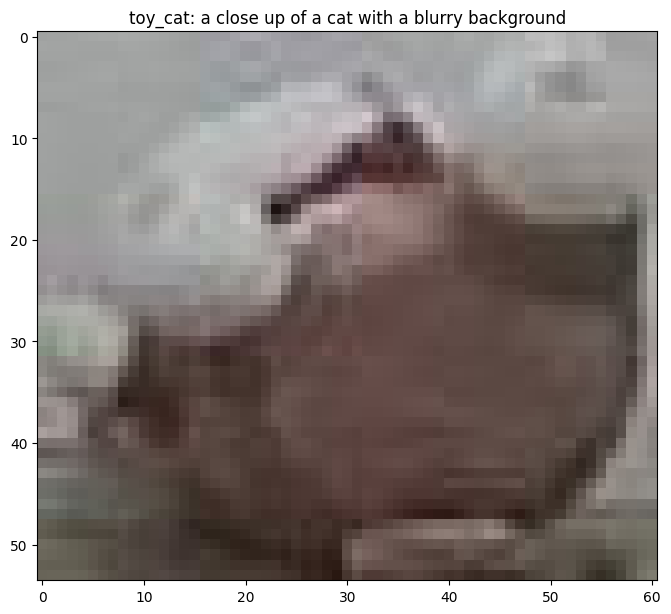

toy_cat: a close up of a cat with a blurry background
Evaluate text quality [-1, 0, 1]: 1
Progress 1033/1402


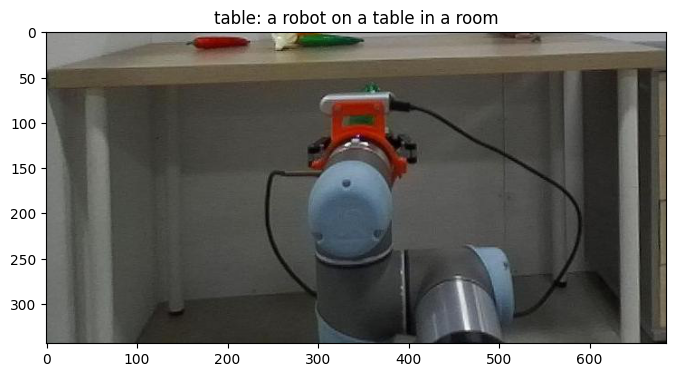

table: a robot on a table in a room
Evaluate text quality [-1, 0, 1]: 0


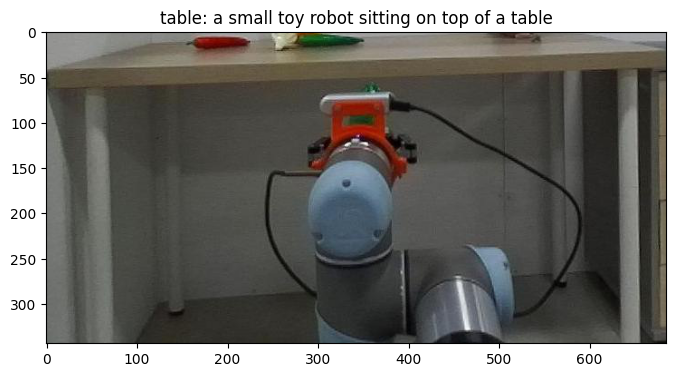

table: a small toy robot sitting on top of a table
Evaluate text quality [-1, 0, 1]: 0
Progress 1046/1402


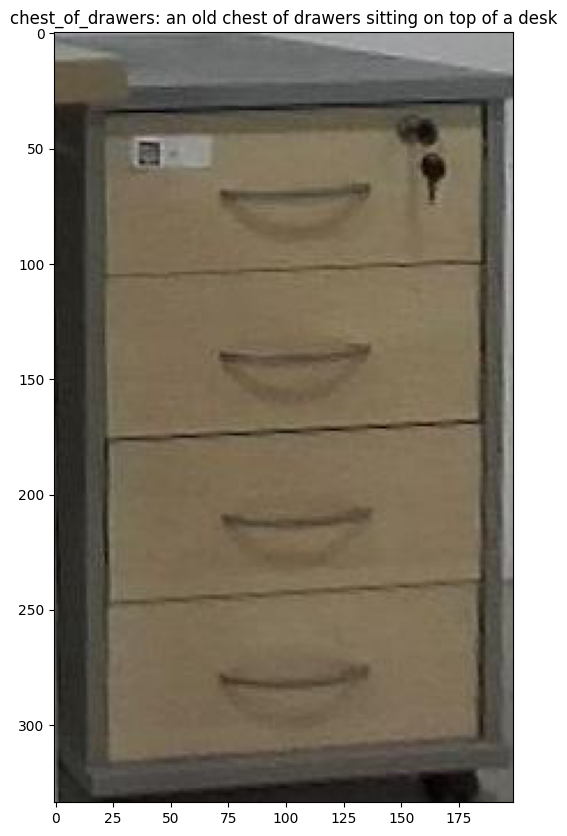

chest_of_drawers: an old chest of drawers sitting on top of a desk
Evaluate text quality [-1, 0, 1]: 0


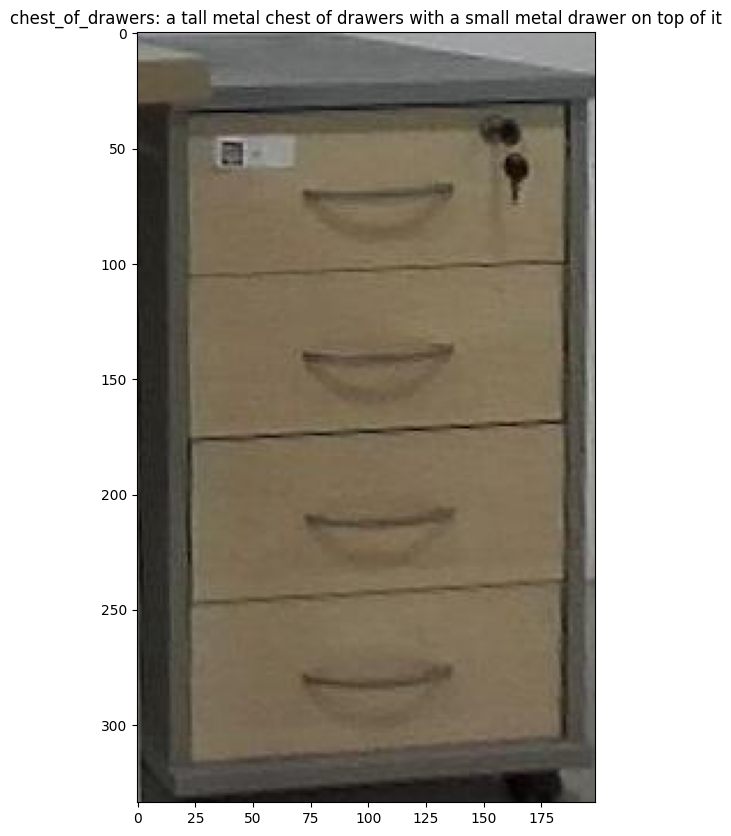

chest_of_drawers: a tall metal chest of drawers with a small metal drawer on top of it
Evaluate text quality [-1, 0, 1]: 0
Progress 1052/1402


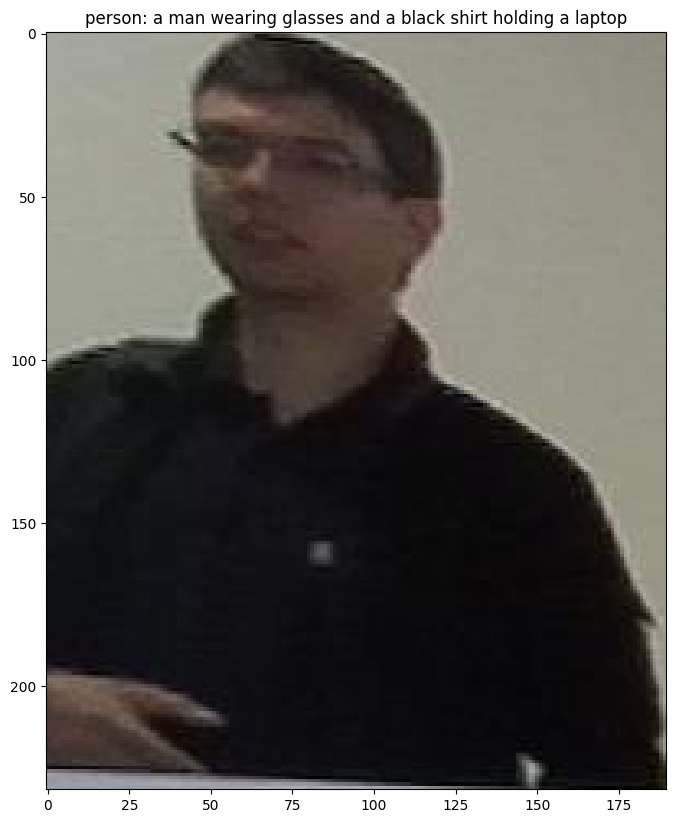

person: a man wearing glasses and a black shirt holding a laptop
Evaluate text quality [-1, 0, 1]: 0


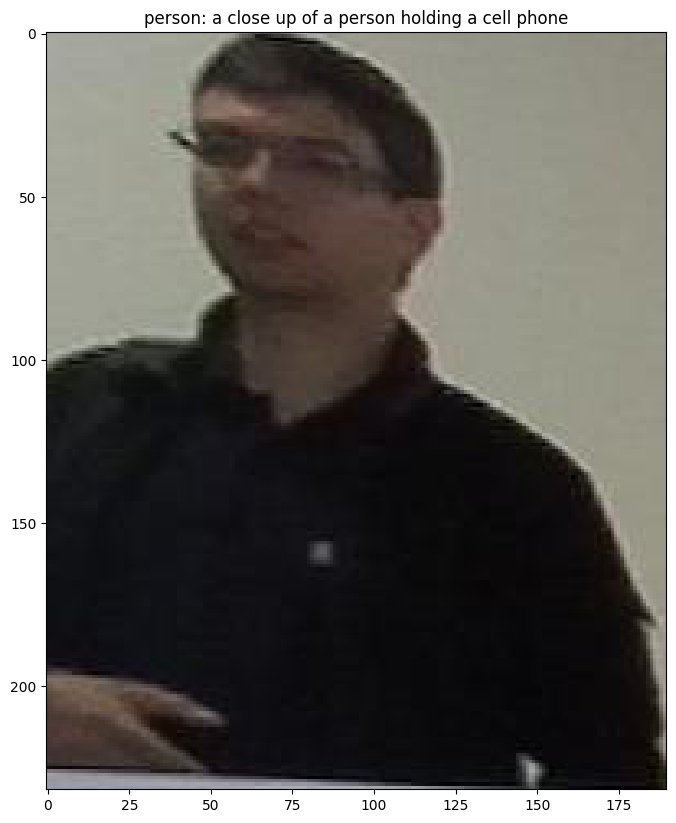

person: a close up of a person holding a cell phone
Evaluate text quality [-1, 0, 1]: 0
Progress 1054/1402


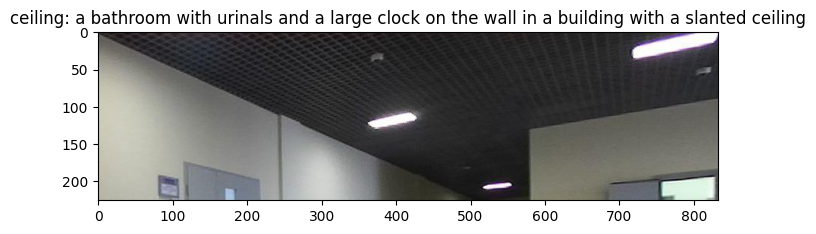

ceiling: a bathroom with urinals and a large clock on the wall in a building with a slanted ceiling
Evaluate text quality [-1, 0, 1]: 


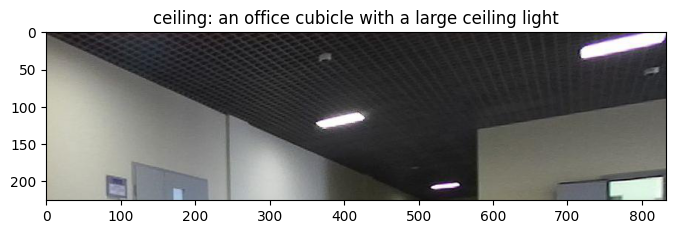

ceiling: an office cubicle with a large ceiling light
Evaluate text quality [-1, 0, 1]: 
Progress 1071/1402


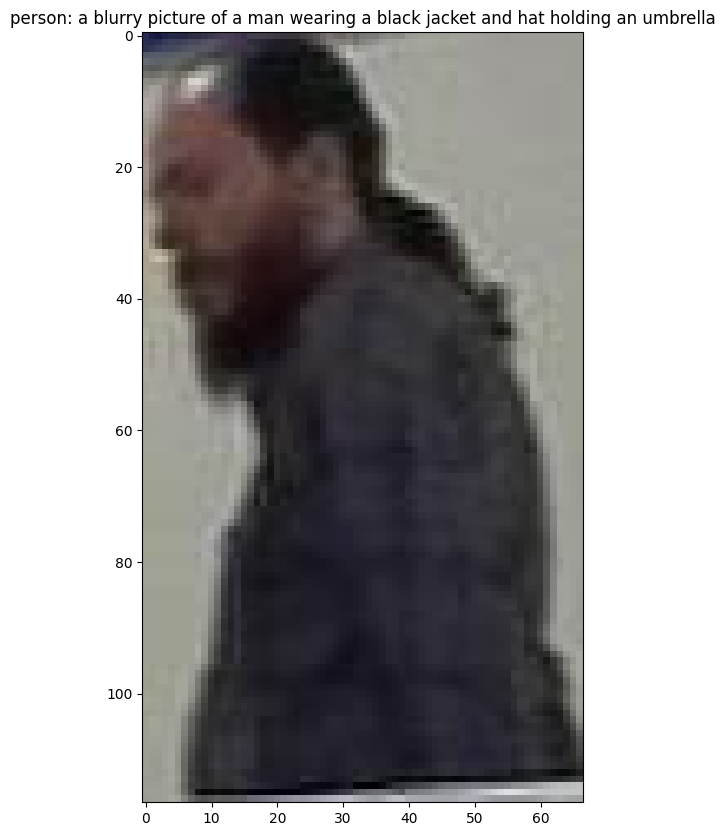

person: a blurry picture of a man wearing a black jacket and hat holding an umbrella
Evaluate text quality [-1, 0, 1]: 0


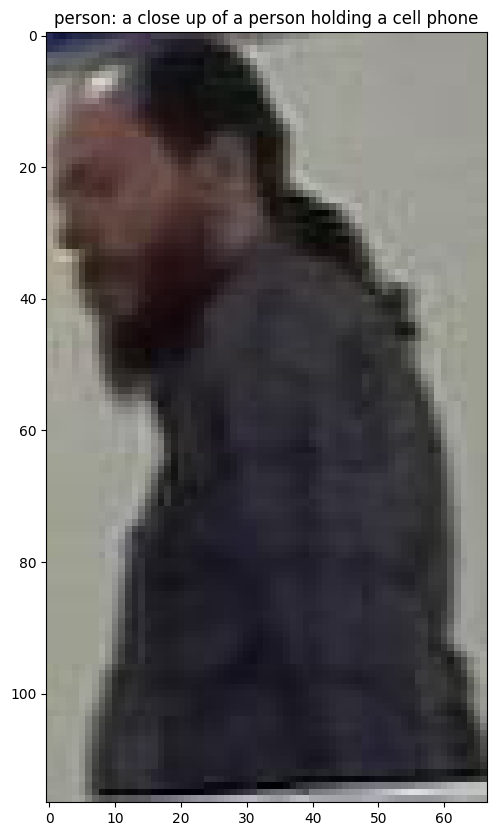

person: a close up of a person holding a cell phone
Evaluate text quality [-1, 0, 1]: 0
Progress 1072/1402


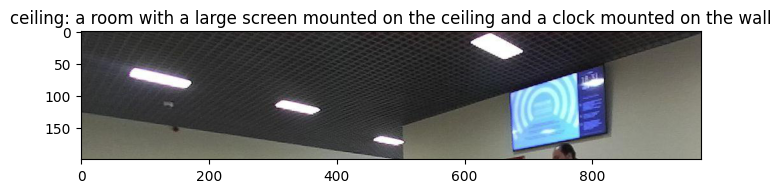

ceiling: a room with a large screen mounted on the ceiling and a clock mounted on the wall
Evaluate text quality [-1, 0, 1]: 


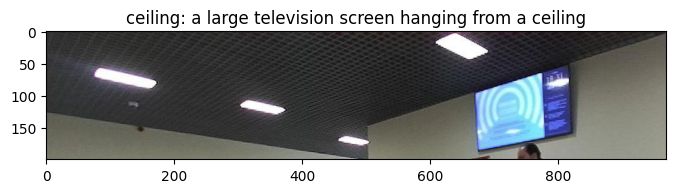

ceiling: a large television screen hanging from a ceiling
Evaluate text quality [-1, 0, 1]: 
Progress 1078/1402


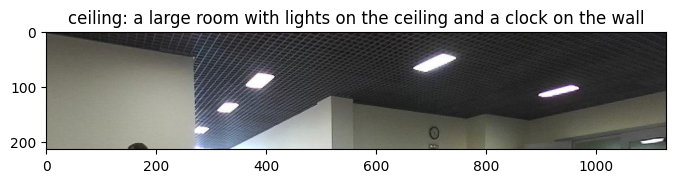

ceiling: a large room with lights on the ceiling and a clock on the wall
Evaluate text quality [-1, 0, 1]: 


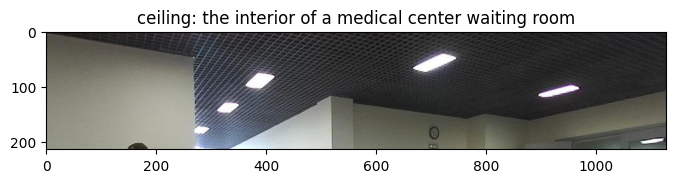

ceiling: the interior of a medical center waiting room
Evaluate text quality [-1, 0, 1]: 
Progress 1084/1402


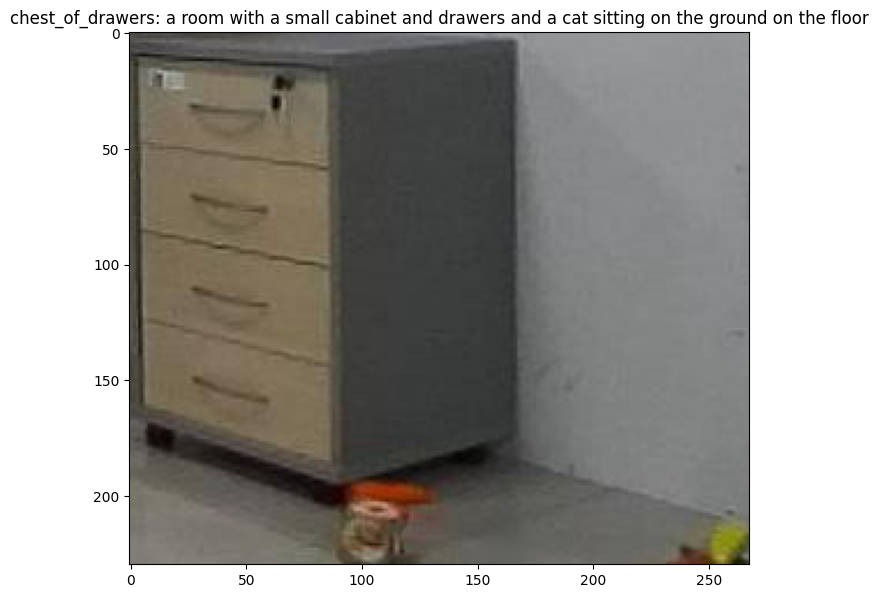

chest_of_drawers: a room with a small cabinet and drawers and a cat sitting on the ground on the floor
Evaluate text quality [-1, 0, 1]: 


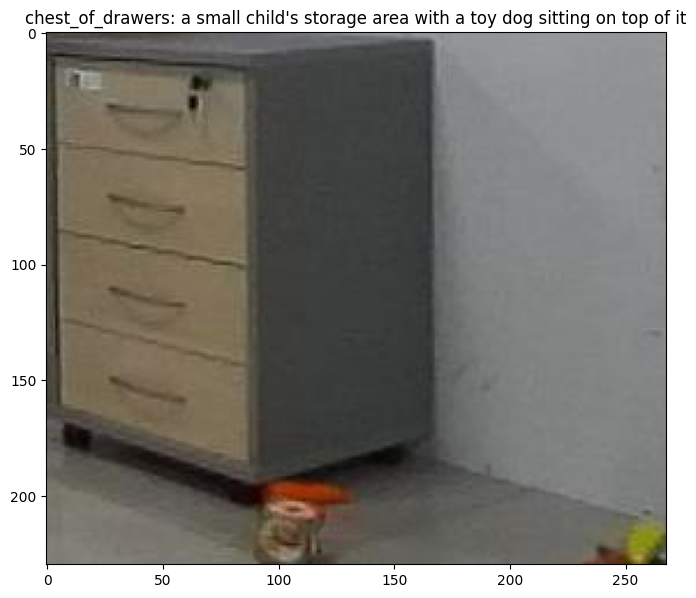

chest_of_drawers: a small child's storage area with a toy dog sitting on top of it
Evaluate text quality [-1, 0, 1]: 
Progress 1096/1402


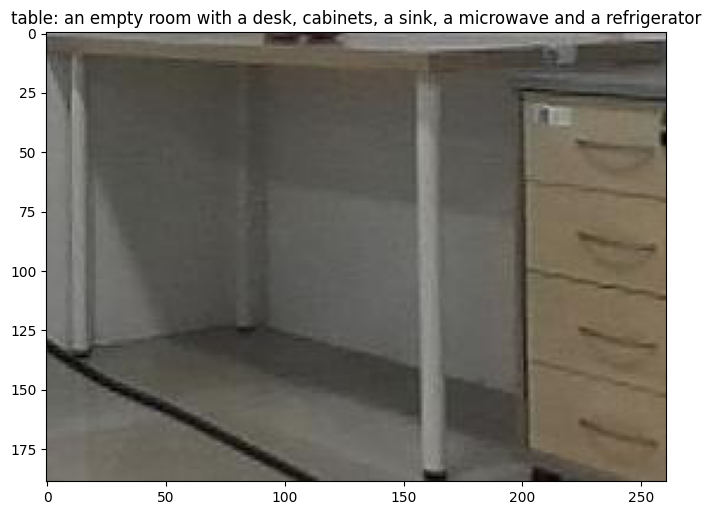

table: an empty room with a desk, cabinets, a sink, a microwave and a refrigerator
Evaluate text quality [-1, 0, 1]: 0


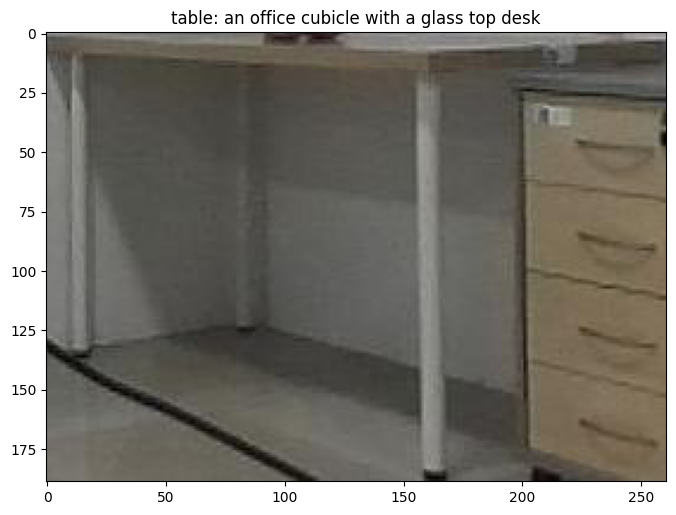

table: an office cubicle with a glass top desk
Evaluate text quality [-1, 0, 1]: 0
Progress 1103/1402


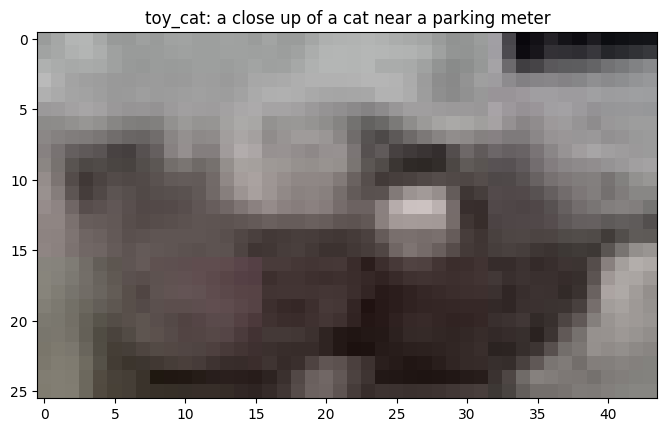

toy_cat: a close up of a cat near a parking meter
Evaluate text quality [-1, 0, 1]: 0


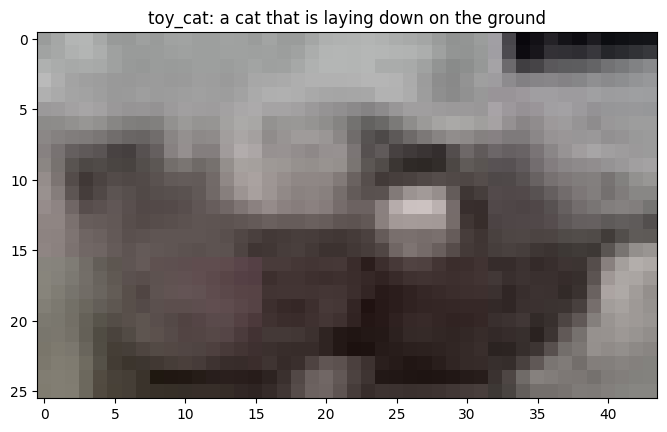

toy_cat: a cat that is laying down on the ground
Evaluate text quality [-1, 0, 1]: 1
Progress 1110/1402


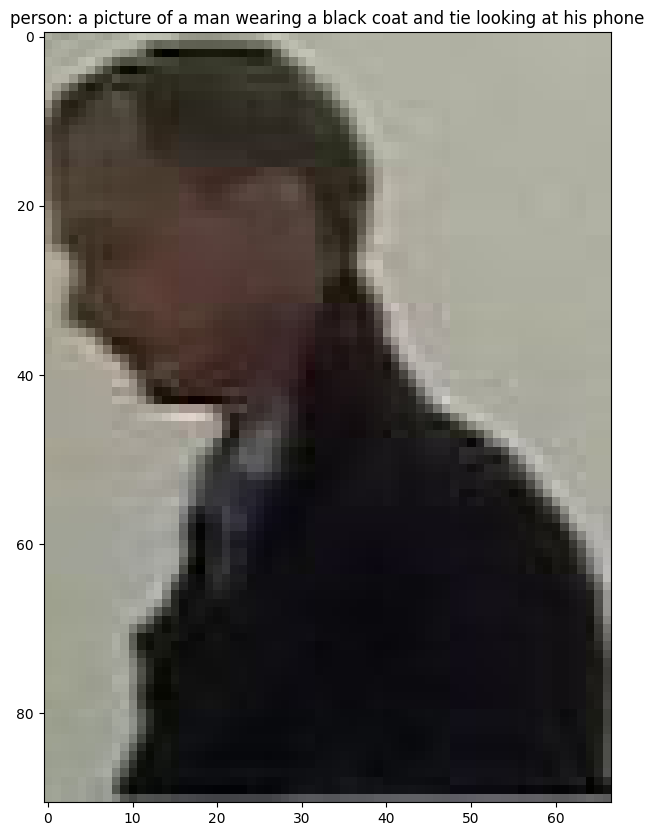

person: a picture of a man wearing a black coat and tie looking at his phone
Evaluate text quality [-1, 0, 1]: 0


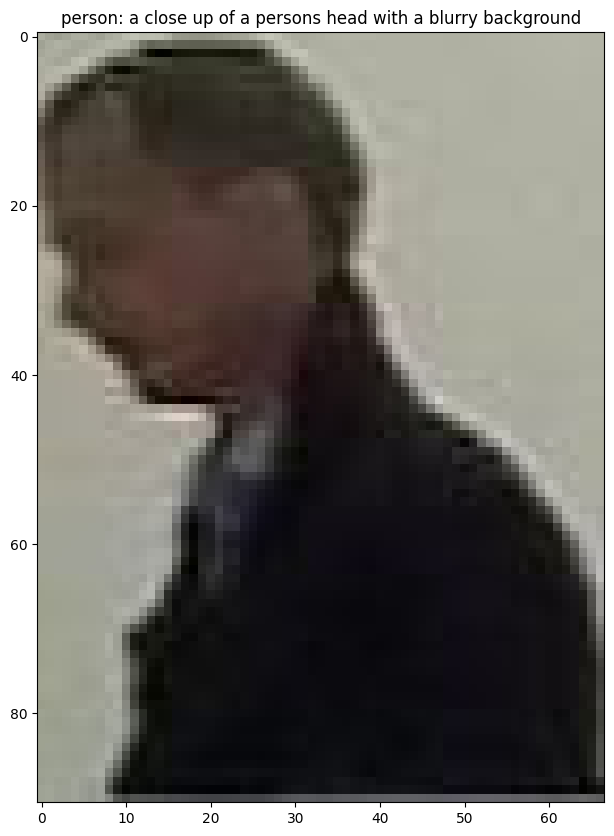

person: a close up of a persons head with a blurry background
Evaluate text quality [-1, 0, 1]: 1
Progress 1114/1402


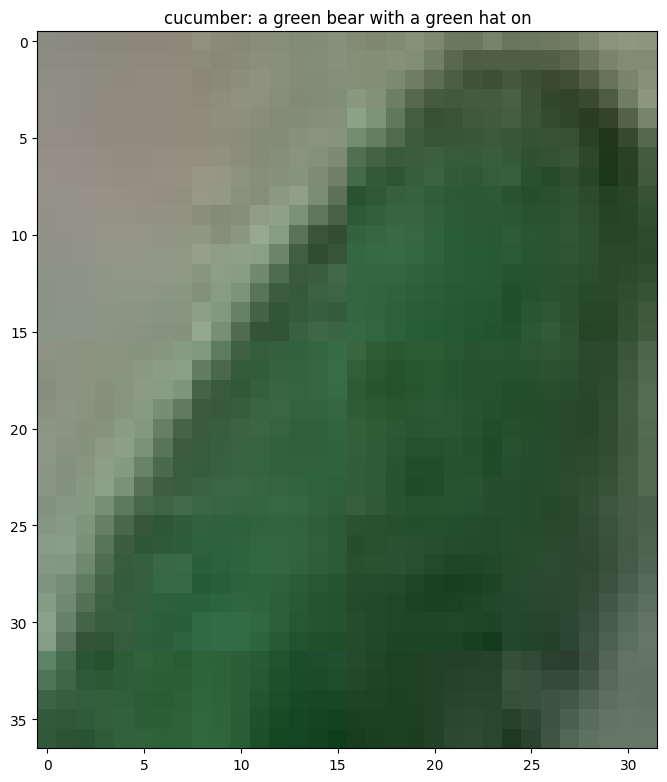

cucumber: a green bear with a green hat on
Evaluate text quality [-1, 0, 1]: 


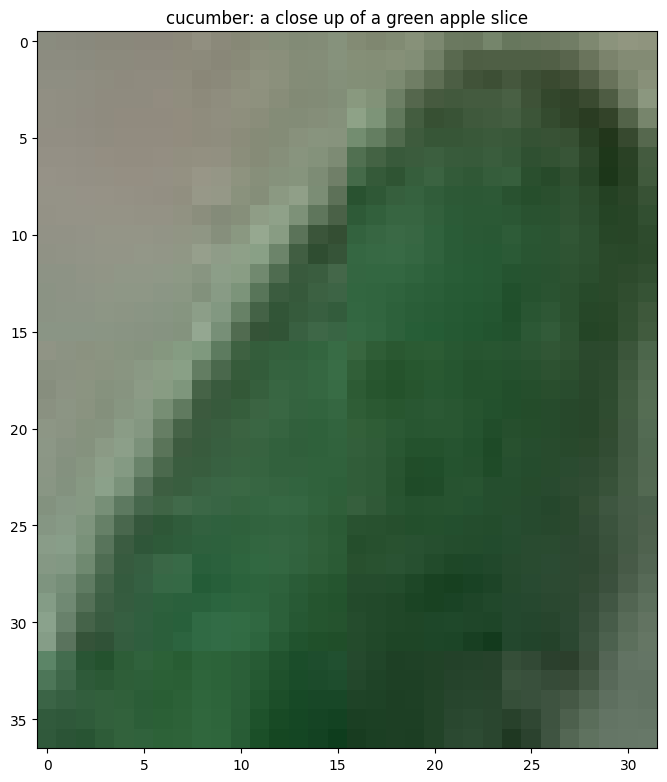

cucumber: a close up of a green apple slice
Evaluate text quality [-1, 0, 1]: 
Progress 1125/1402


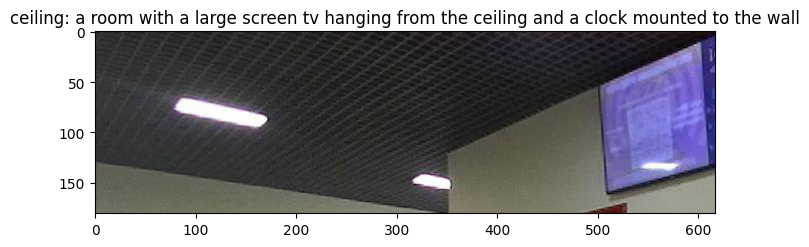

ceiling: a room with a large screen tv hanging from the ceiling and a clock mounted to the wall
Evaluate text quality [-1, 0, 1]: 


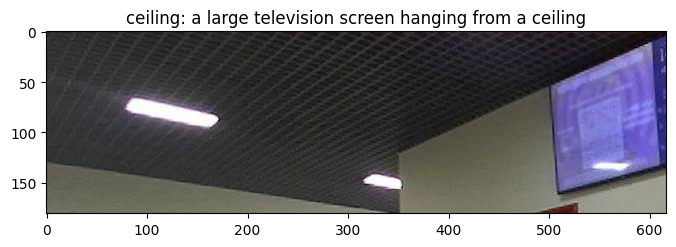

ceiling: a large television screen hanging from a ceiling
Evaluate text quality [-1, 0, 1]: 
Progress 1132/1402


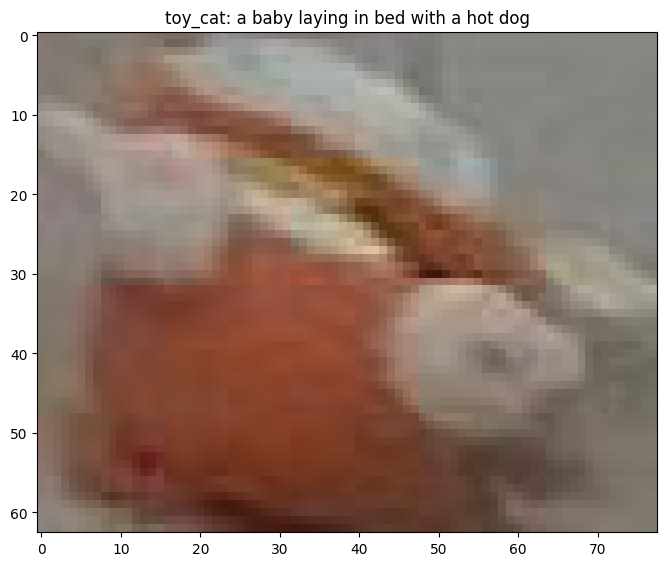

toy_cat: a baby laying in bed with a hot dog
Evaluate text quality [-1, 0, 1]: 


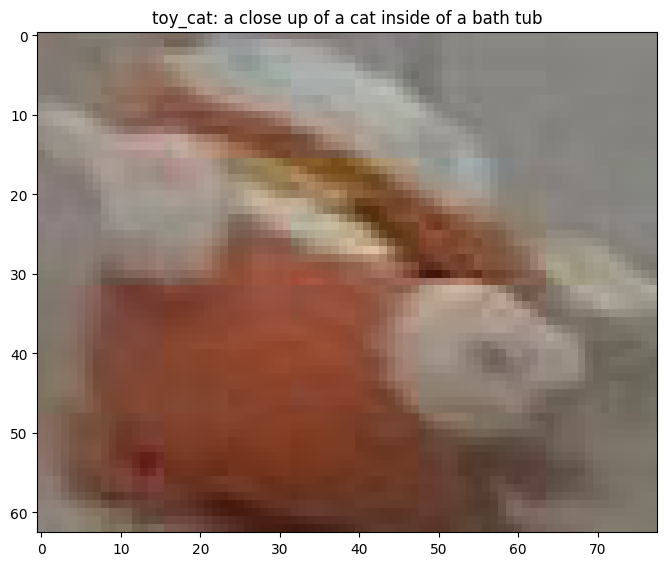

toy_cat: a close up of a cat inside of a bath tub
Evaluate text quality [-1, 0, 1]: 0
Progress 1139/1402


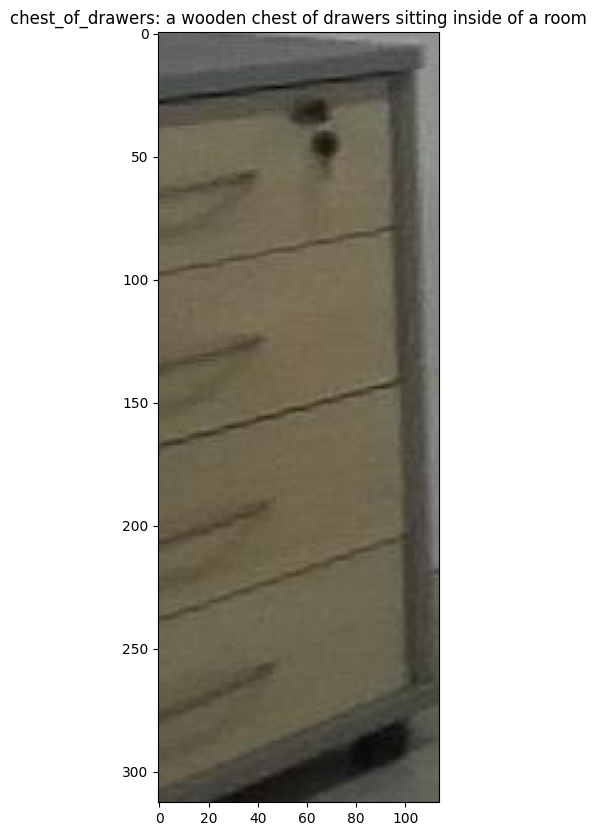

chest_of_drawers: a wooden chest of drawers sitting inside of a room
Evaluate text quality [-1, 0, 1]: 1


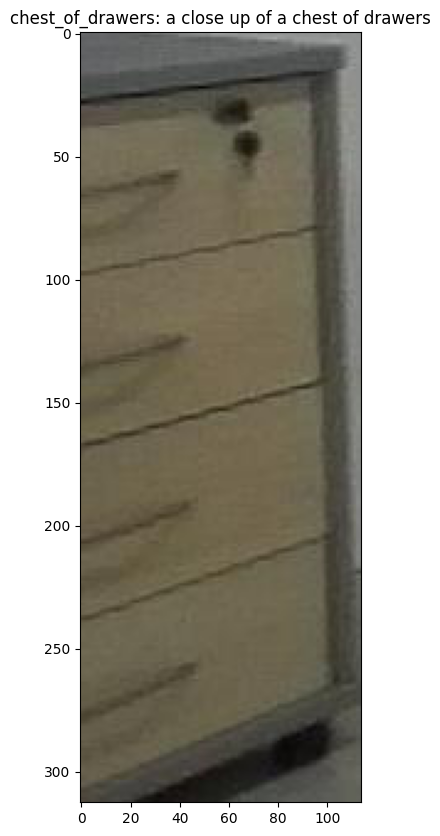

chest_of_drawers: a close up of a chest of drawers
Evaluate text quality [-1, 0, 1]: 1
Progress 1140/1402


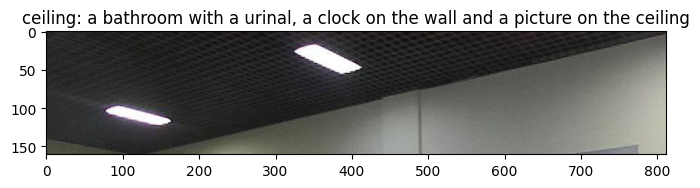

ceiling: a bathroom with a urinal, a clock on the wall and a picture on the ceiling
Evaluate text quality [-1, 0, 1]: 


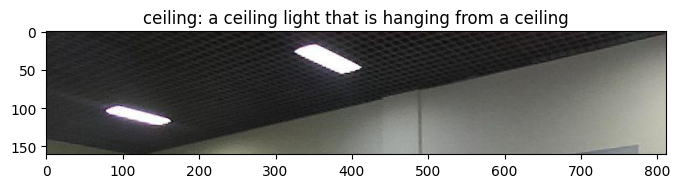

ceiling: a ceiling light that is hanging from a ceiling
Evaluate text quality [-1, 0, 1]: 
Progress 1151/1402


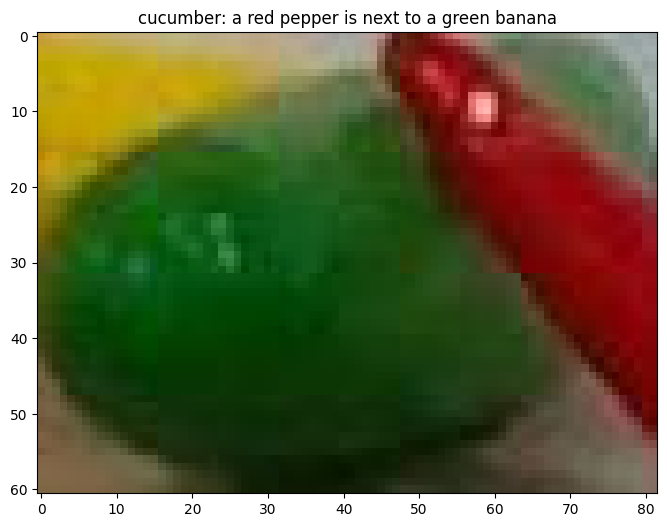

cucumber: a red pepper is next to a green banana
Evaluate text quality [-1, 0, 1]: 


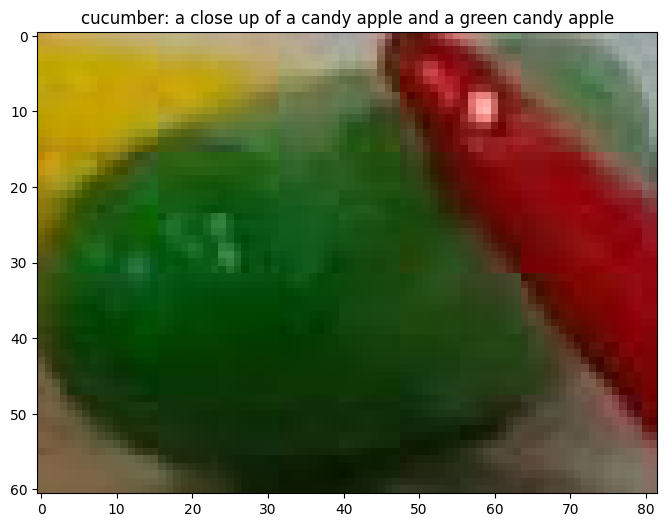

cucumber: a close up of a candy apple and a green candy apple
Evaluate text quality [-1, 0, 1]: 
Progress 1168/1402


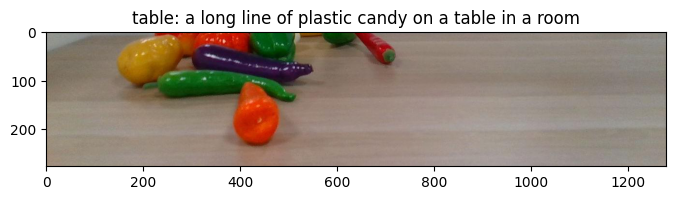

table: a long line of plastic candy on a table in a room
Evaluate text quality [-1, 0, 1]: 0


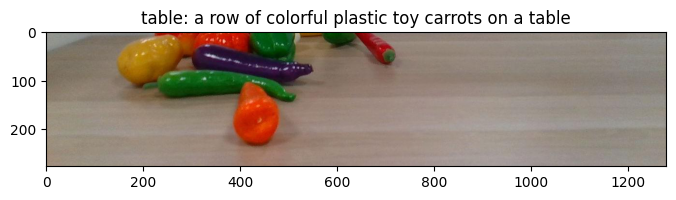

table: a row of colorful plastic toy carrots on a table
Evaluate text quality [-1, 0, 1]: 0
Progress 1169/1402


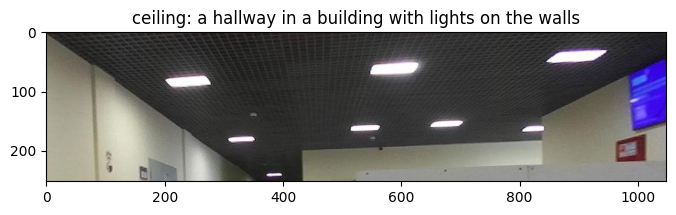

ceiling: a hallway in a building with lights on the walls
Evaluate text quality [-1, 0, 1]: 


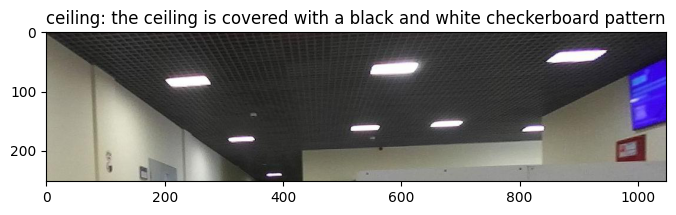

ceiling: the ceiling is covered with a black and white checkerboard pattern
Evaluate text quality [-1, 0, 1]: 0
Progress 1182/1402


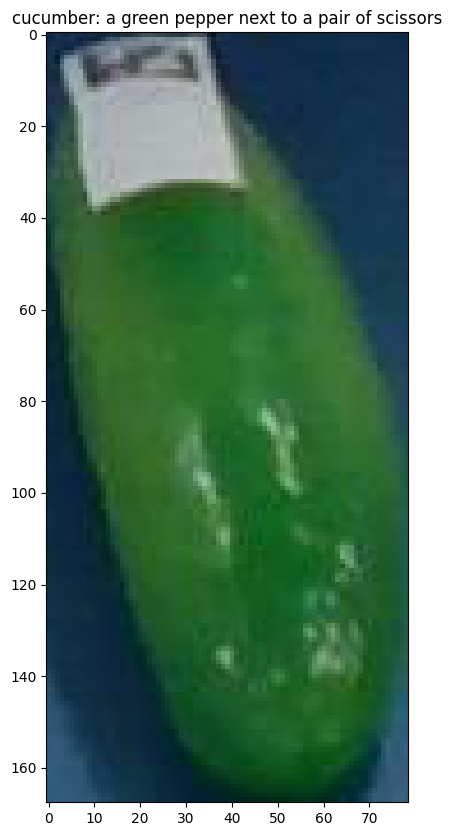

cucumber: a green pepper next to a pair of scissors
Evaluate text quality [-1, 0, 1]: 


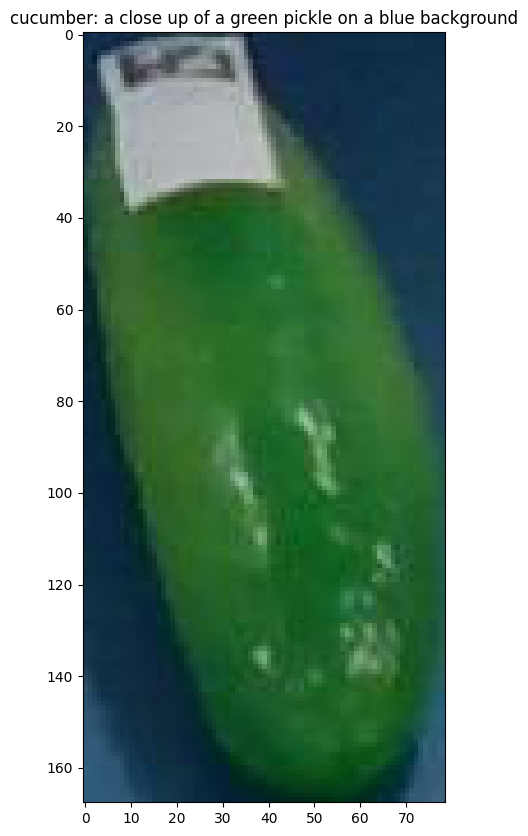

cucumber: a close up of a green pickle on a blue background
Evaluate text quality [-1, 0, 1]: 1
Progress 1184/1402


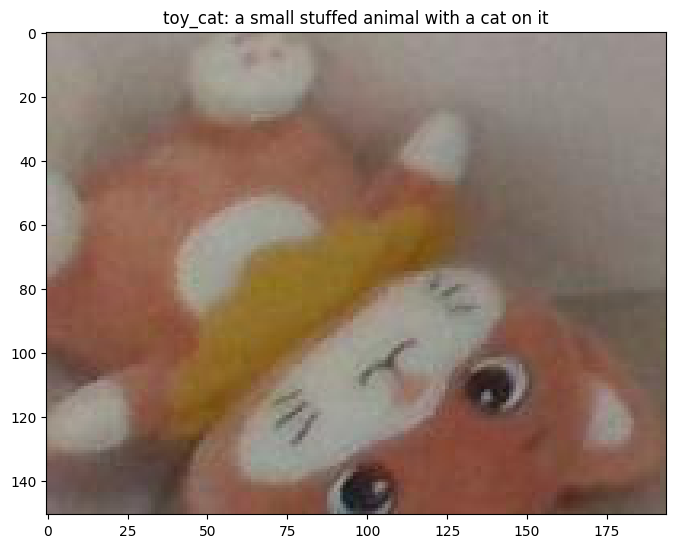

toy_cat: a small stuffed animal with a cat on it
Evaluate text quality [-1, 0, 1]: 0


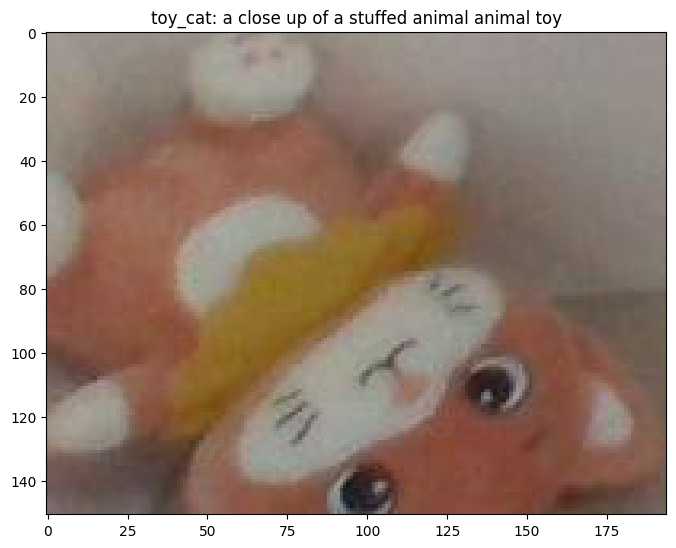

toy_cat: a close up of a stuffed animal animal toy
Evaluate text quality [-1, 0, 1]: 1
Progress 1194/1402


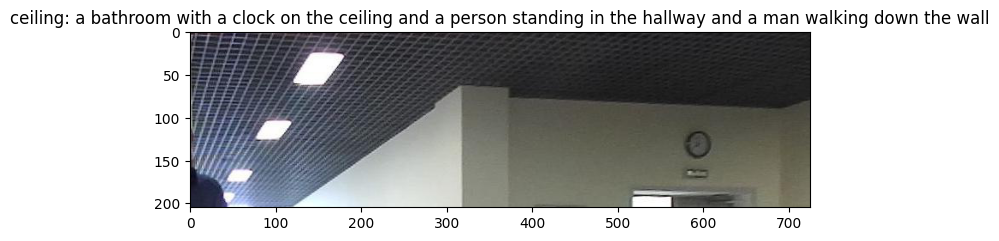

ceiling: a bathroom with a clock on the ceiling and a person standing in the hallway and a man walking down the wall
Evaluate text quality [-1, 0, 1]: 


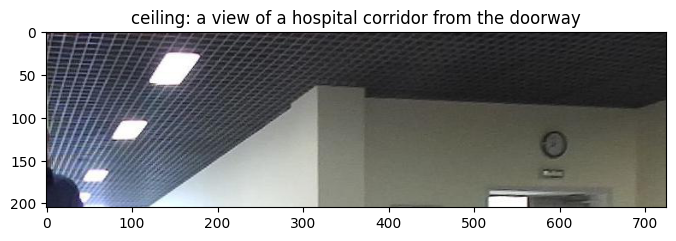

ceiling: a view of a hospital corridor from the doorway
Evaluate text quality [-1, 0, 1]: 
Progress 1197/1402


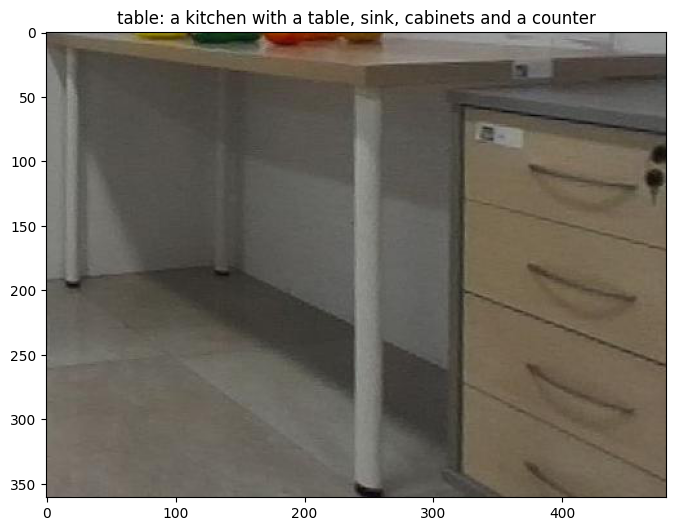

table: a kitchen with a table, sink, cabinets and a counter
Evaluate text quality [-1, 0, 1]: 0


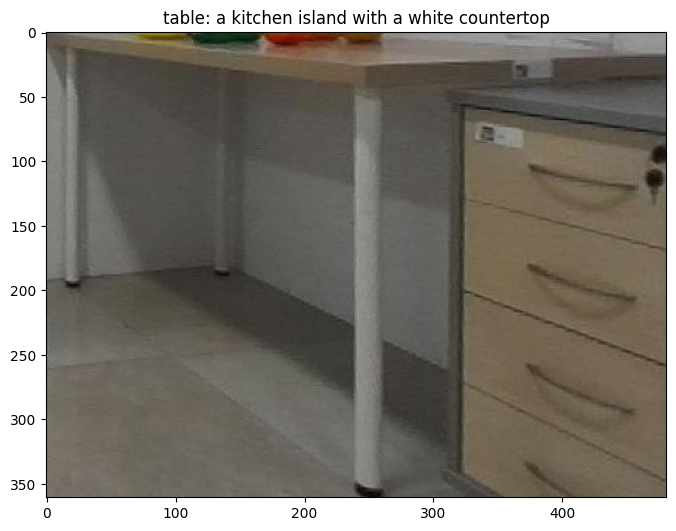

table: a kitchen island with a white countertop
Evaluate text quality [-1, 0, 1]: 
Progress 1199/1402


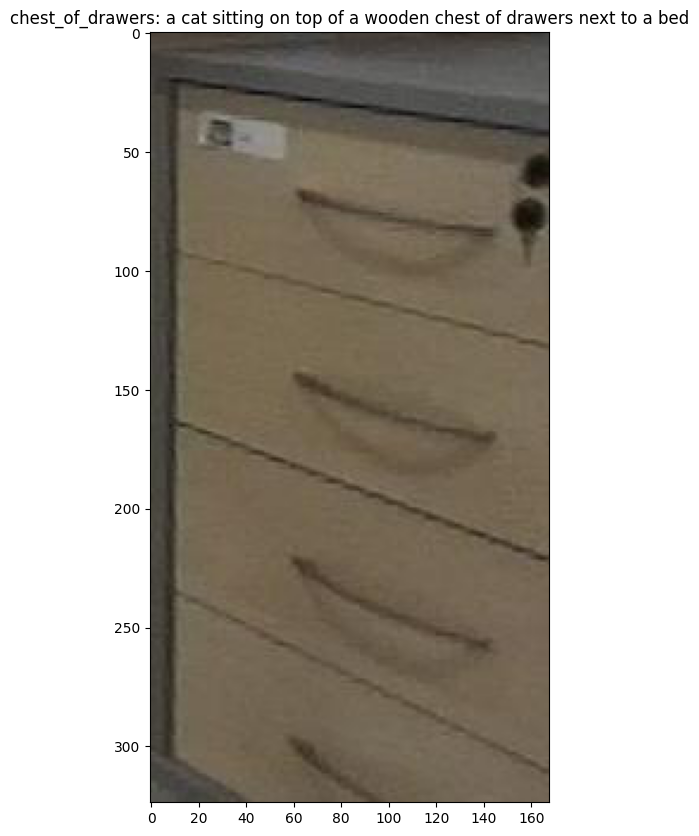

chest_of_drawers: a cat sitting on top of a wooden chest of drawers next to a bed
Evaluate text quality [-1, 0, 1]: 0


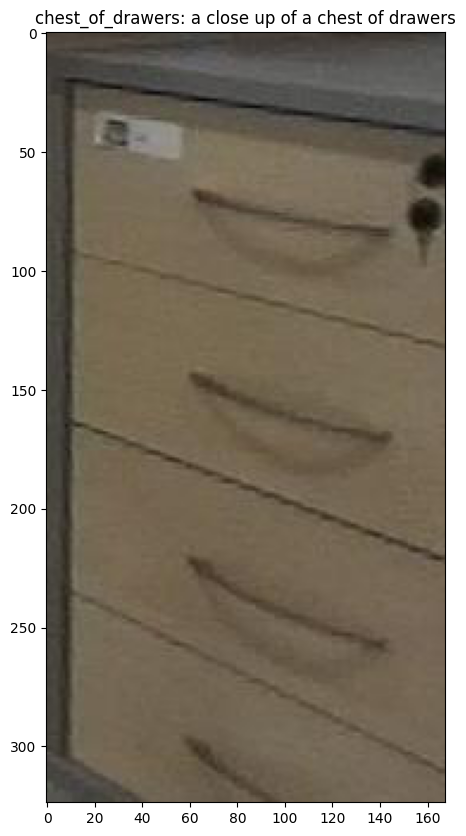

chest_of_drawers: a close up of a chest of drawers
Evaluate text quality [-1, 0, 1]: 1
Progress 1202/1402


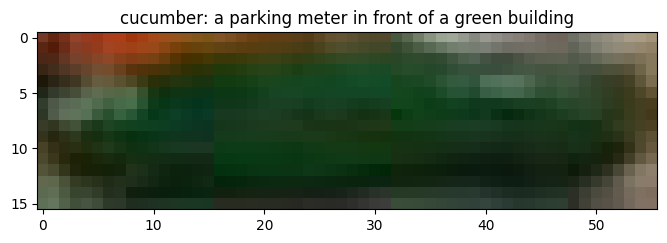

cucumber: a parking meter in front of a green building
Evaluate text quality [-1, 0, 1]: 


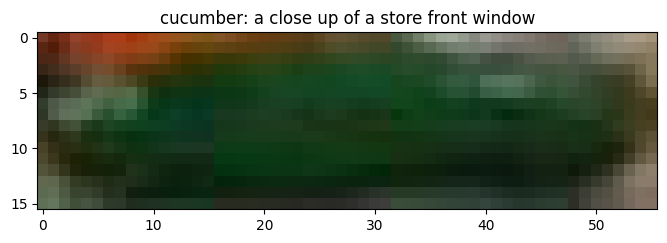

cucumber: a close up of a store front window
Evaluate text quality [-1, 0, 1]: 
Progress 1203/1402


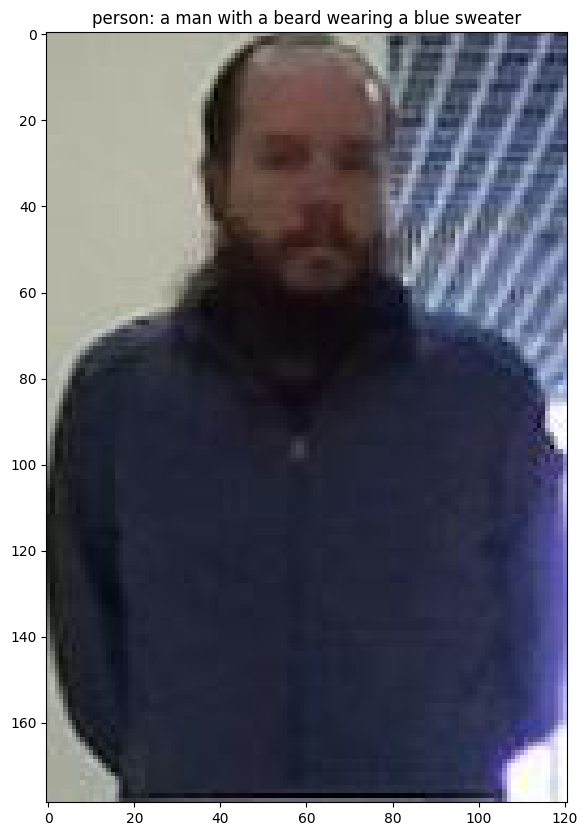

person: a man with a beard wearing a blue sweater
Evaluate text quality [-1, 0, 1]: 1


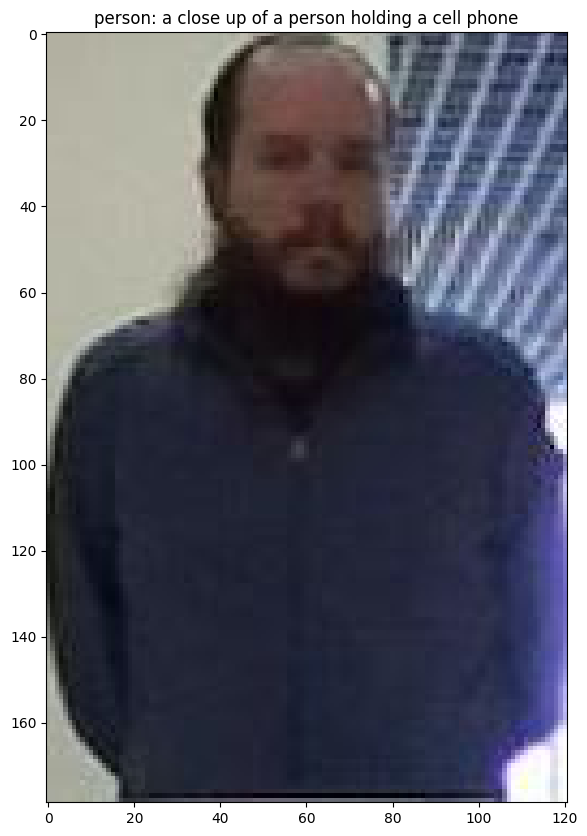

person: a close up of a person holding a cell phone
Evaluate text quality [-1, 0, 1]: 0
Progress 1210/1402


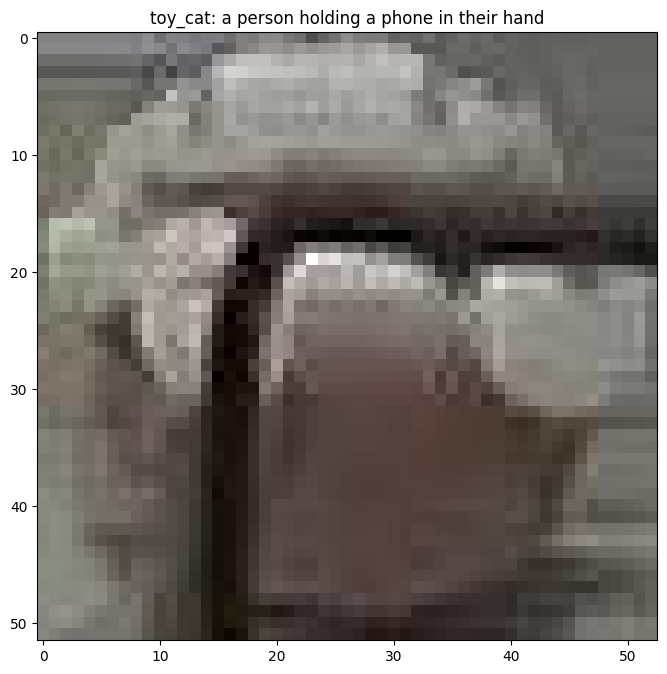

toy_cat: a person holding a phone in their hand
Evaluate text quality [-1, 0, 1]: 


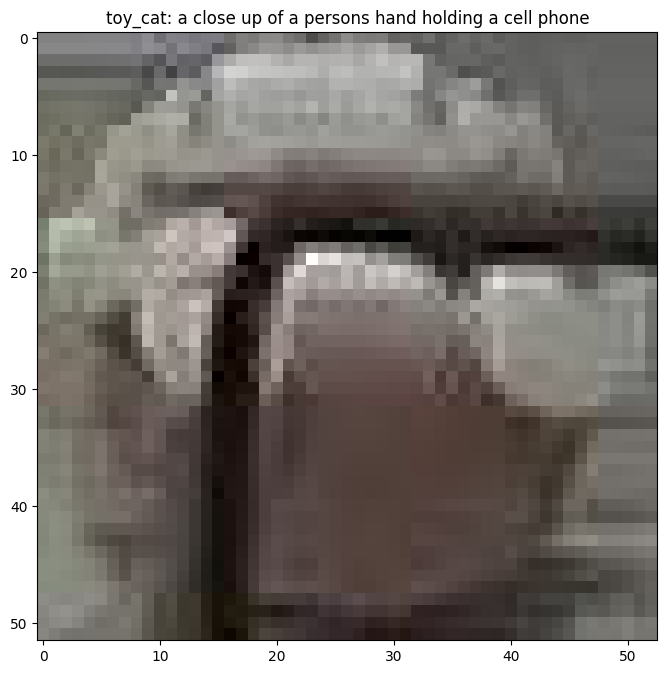

toy_cat: a close up of a persons hand holding a cell phone
Evaluate text quality [-1, 0, 1]: 
Progress 1215/1402


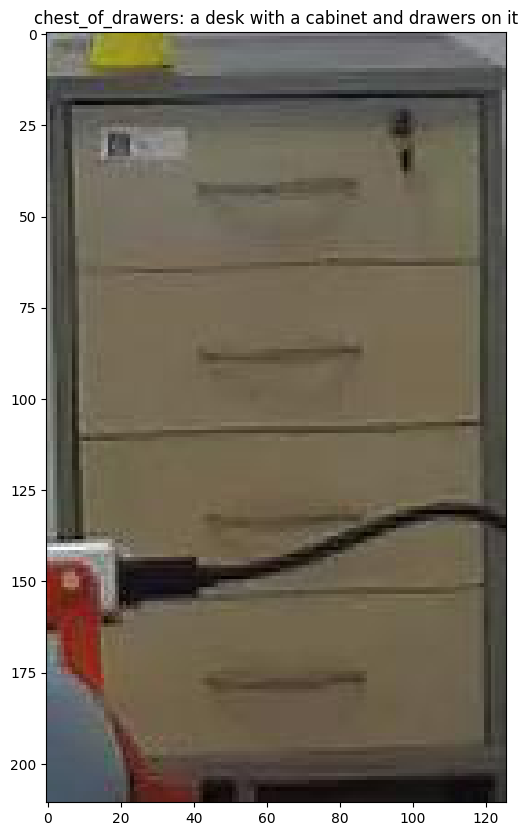

chest_of_drawers: a desk with a cabinet and drawers on it
Evaluate text quality [-1, 0, 1]: 0


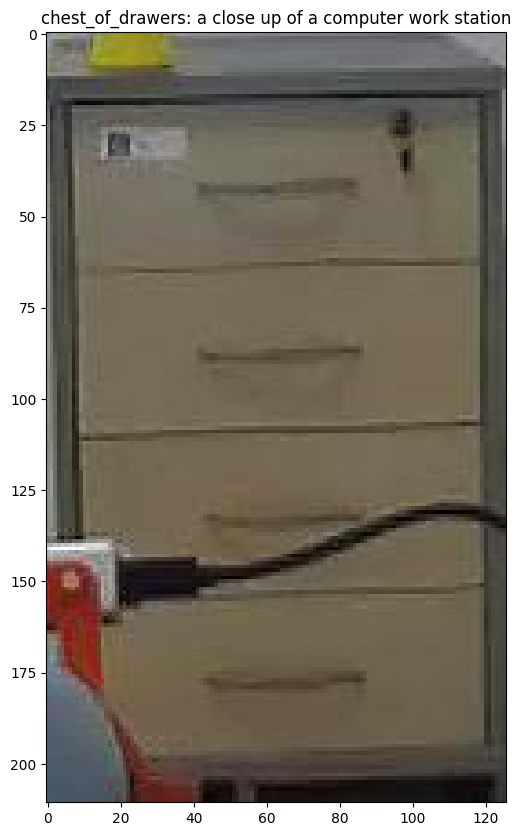

chest_of_drawers: a close up of a computer work station
Evaluate text quality [-1, 0, 1]: 
Progress 1223/1402


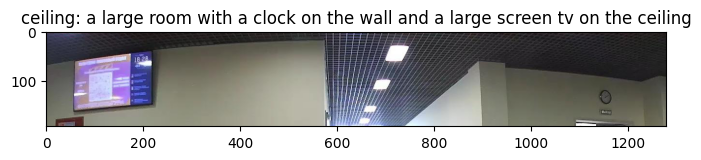

ceiling: a large room with a clock on the wall and a large screen tv on the ceiling
Evaluate text quality [-1, 0, 1]: 


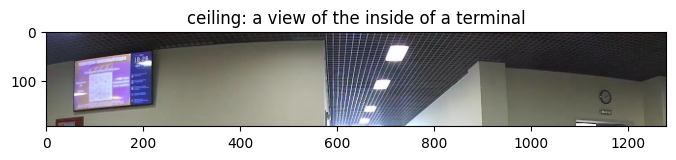

ceiling: a view of the inside of a terminal
Evaluate text quality [-1, 0, 1]: 
Progress 1228/1402


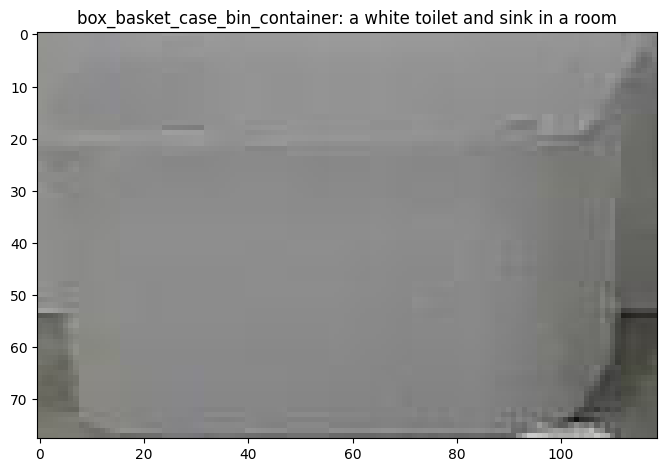

box_basket_case_bin_container: a white toilet and sink in a room
Evaluate text quality [-1, 0, 1]: 


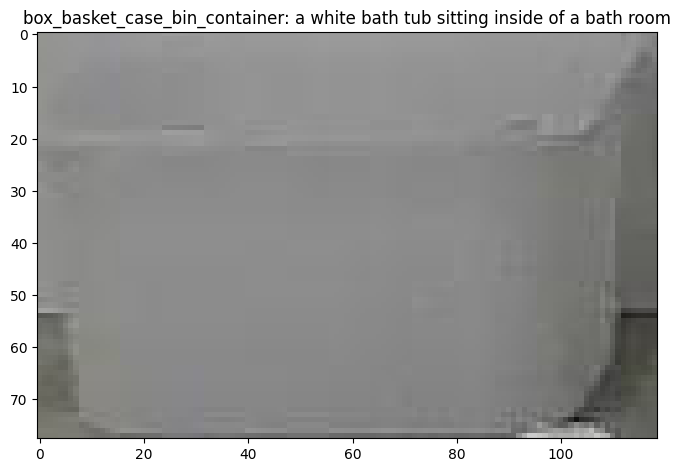

box_basket_case_bin_container: a white bath tub sitting inside of a bath room
Evaluate text quality [-1, 0, 1]: 
Progress 1229/1402


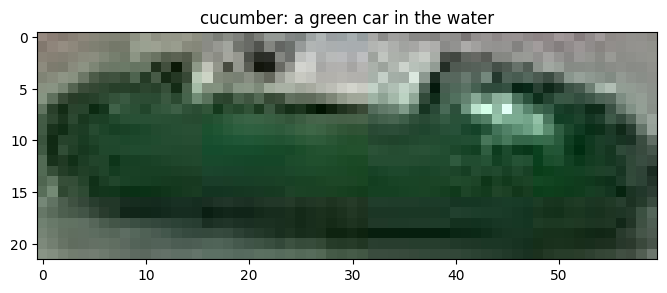

cucumber: a green car in the water
Evaluate text quality [-1, 0, 1]: 


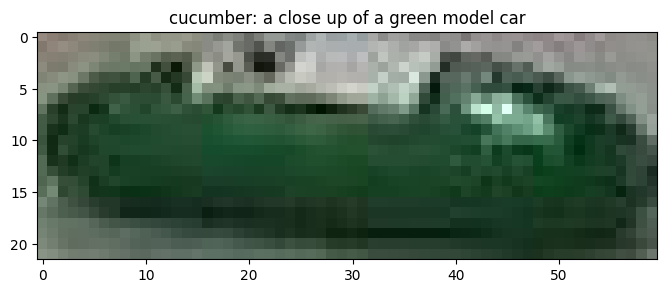

cucumber: a close up of a green model car
Evaluate text quality [-1, 0, 1]: 
Progress 1244/1402


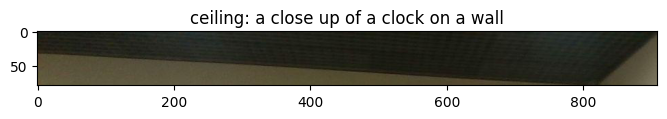

ceiling: a close up of a clock on a wall
Evaluate text quality [-1, 0, 1]: 


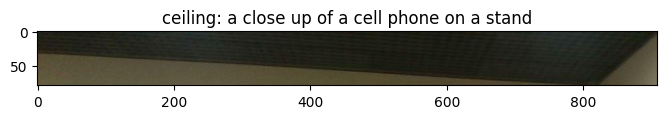

ceiling: a close up of a cell phone on a stand
Evaluate text quality [-1, 0, 1]: 
Progress 1245/1402


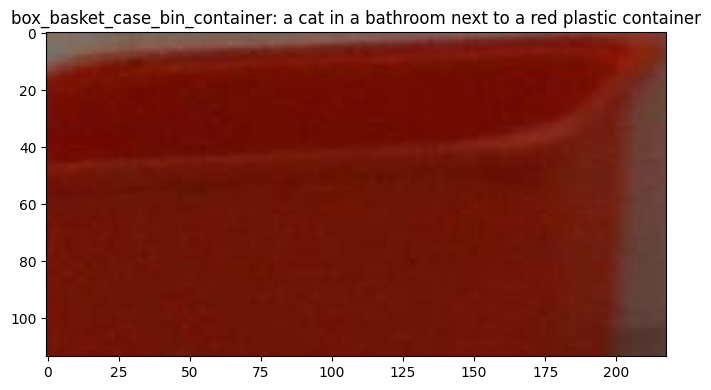

box_basket_case_bin_container: a cat in a bathroom next to a red plastic container
Evaluate text quality [-1, 0, 1]: 


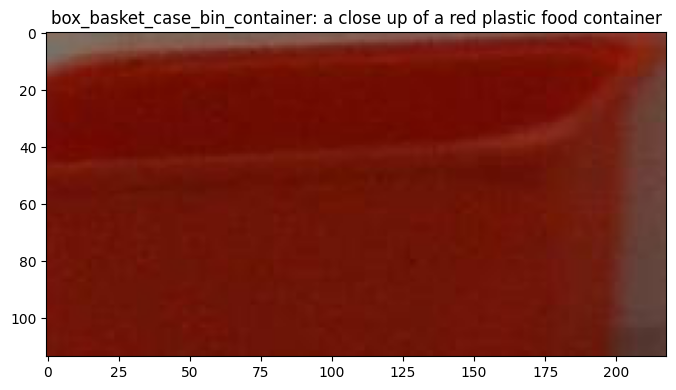

box_basket_case_bin_container: a close up of a red plastic food container
Evaluate text quality [-1, 0, 1]: 0
Progress 1246/1402


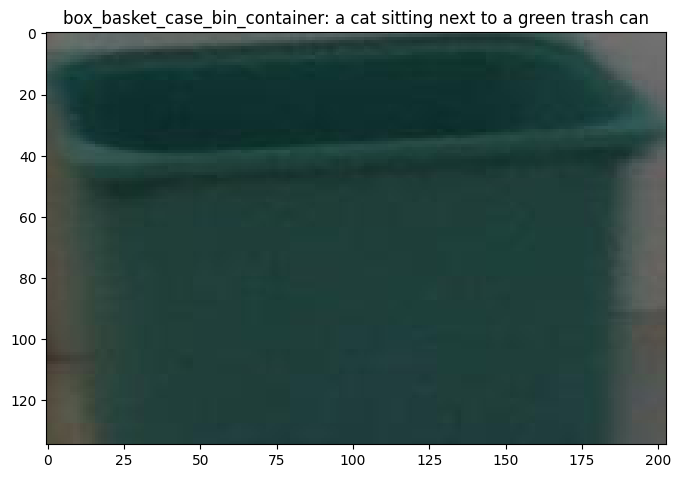

box_basket_case_bin_container: a cat sitting next to a green trash can
Evaluate text quality [-1, 0, 1]: 


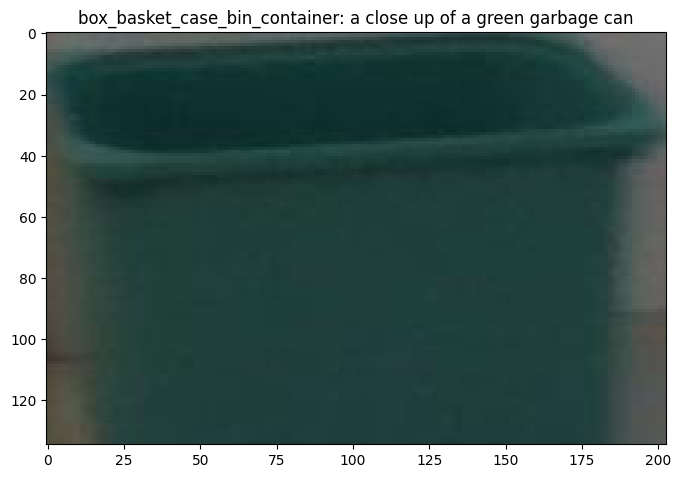

box_basket_case_bin_container: a close up of a green garbage can
Evaluate text quality [-1, 0, 1]: 0
Progress 1252/1402


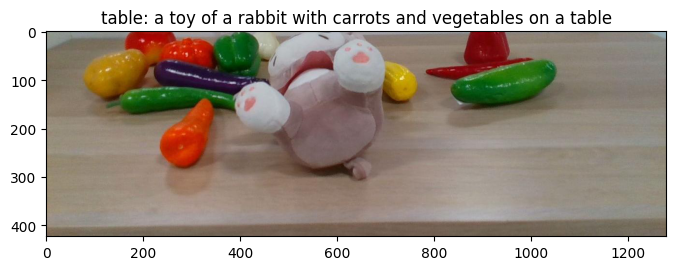

table: a toy of a rabbit with carrots and vegetables on a table
Evaluate text quality [-1, 0, 1]: 0


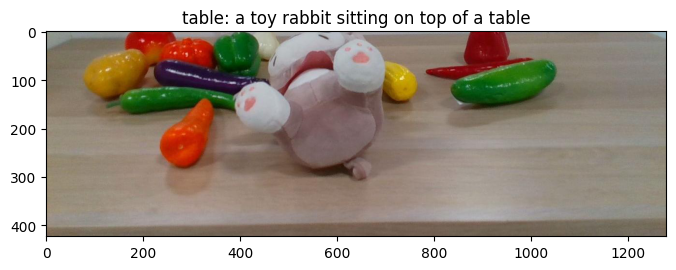

table: a toy rabbit sitting on top of a table
Evaluate text quality [-1, 0, 1]: 
Progress 1256/1402


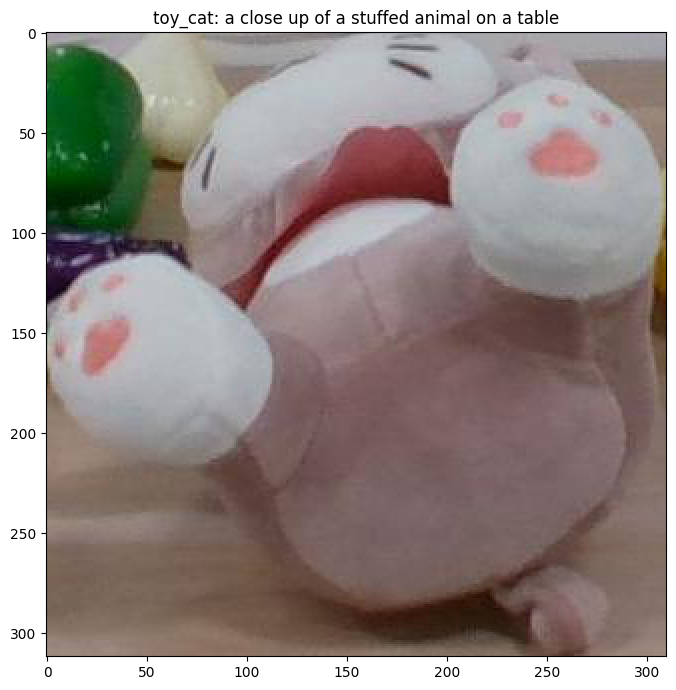

toy_cat: a close up of a stuffed animal on a table
Evaluate text quality [-1, 0, 1]: 1


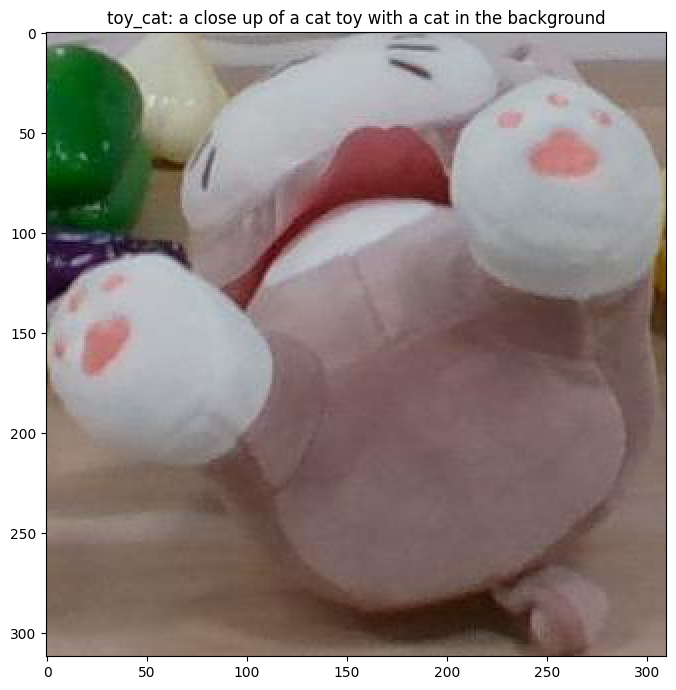

toy_cat: a close up of a cat toy with a cat in the background
Evaluate text quality [-1, 0, 1]: 0
Progress 1261/1402


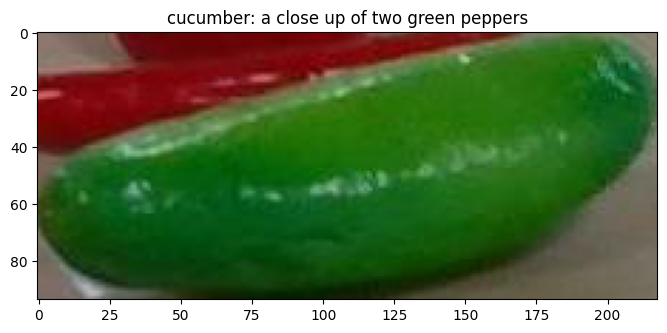

cucumber: a close up of two green peppers
Evaluate text quality [-1, 0, 1]: 


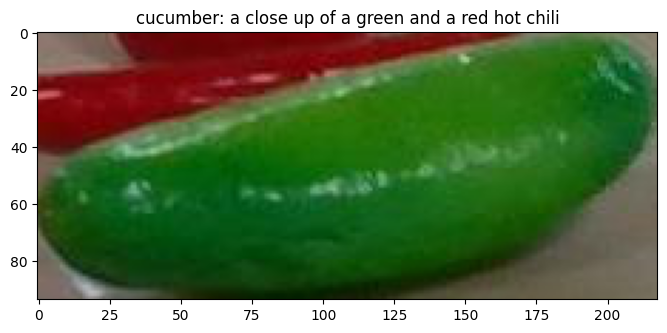

cucumber: a close up of a green and a red hot chili
Evaluate text quality [-1, 0, 1]: 
Progress 1266/1402


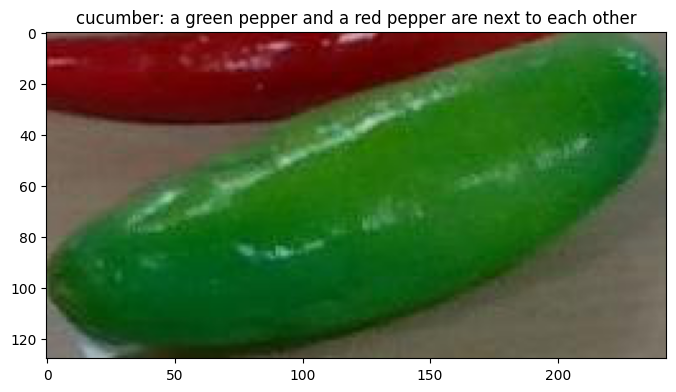

cucumber: a green pepper and a red pepper are next to each other
Evaluate text quality [-1, 0, 1]: 


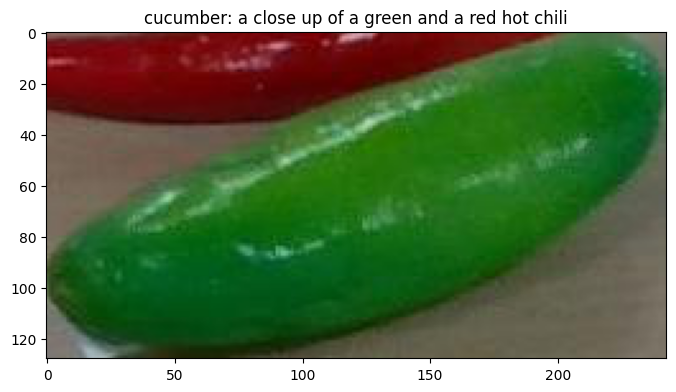

cucumber: a close up of a green and a red hot chili
Evaluate text quality [-1, 0, 1]: 
Progress 1268/1402


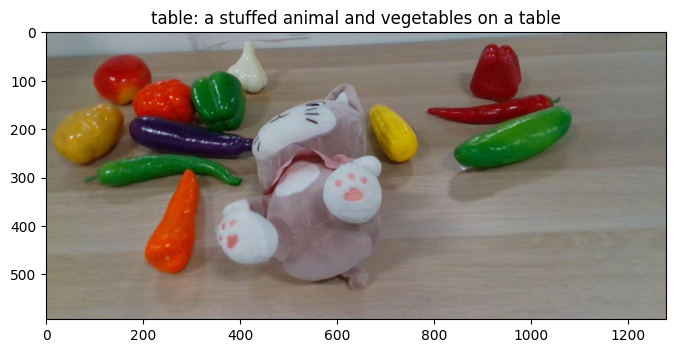

table: a stuffed animal and vegetables on a table
Evaluate text quality [-1, 0, 1]: 1


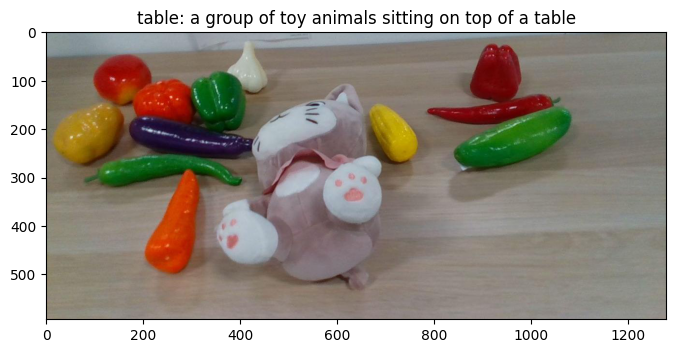

table: a group of toy animals sitting on top of a table
Evaluate text quality [-1, 0, 1]: 1
Progress 1279/1402


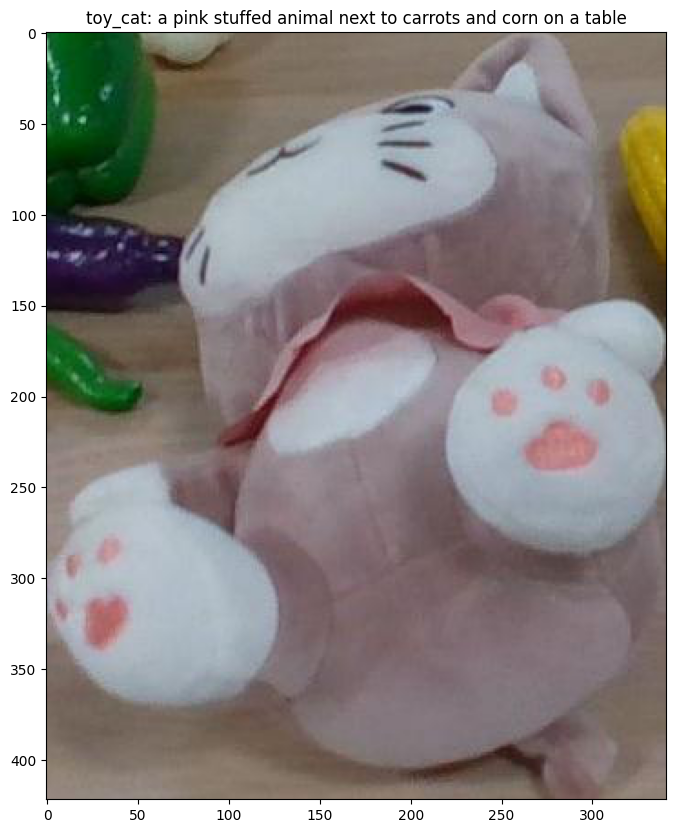

toy_cat: a pink stuffed animal next to carrots and corn on a table
Evaluate text quality [-1, 0, 1]: 0


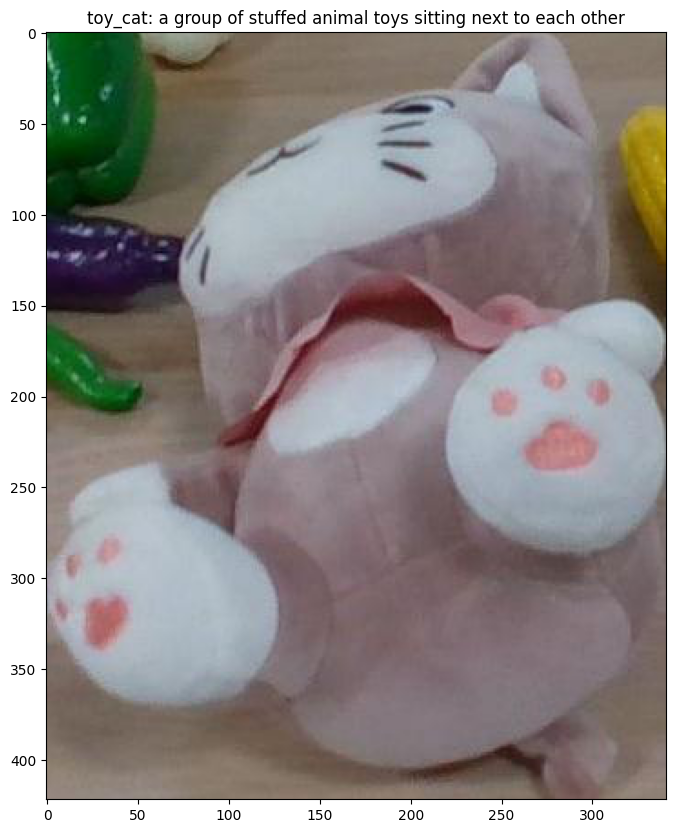

toy_cat: a group of stuffed animal toys sitting next to each other
Evaluate text quality [-1, 0, 1]: 0
Progress 1284/1402


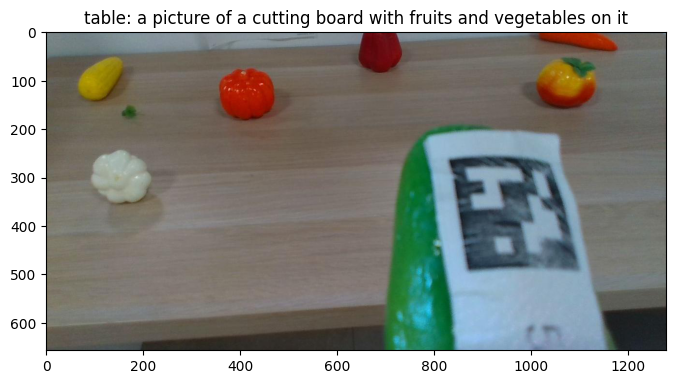

table: a picture of a cutting board with fruits and vegetables on it
Evaluate text quality [-1, 0, 1]: 


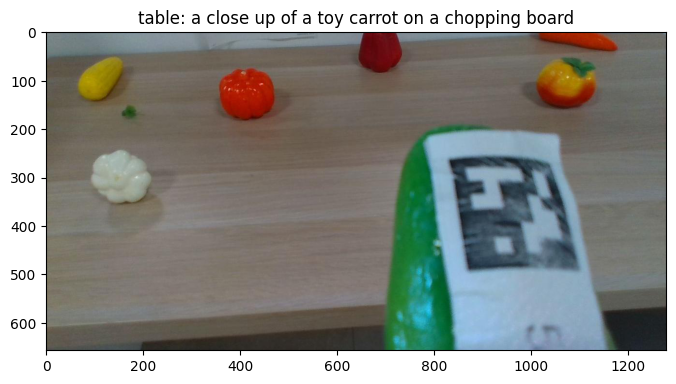

table: a close up of a toy carrot on a chopping board
Evaluate text quality [-1, 0, 1]: 
Progress 1289/1402


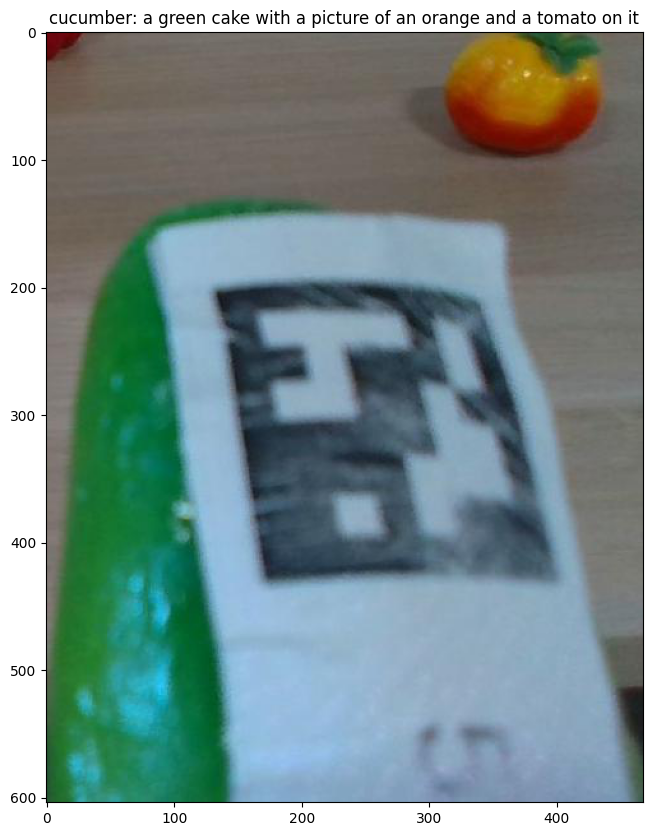

cucumber: a green cake with a picture of an orange and a tomato on it
Evaluate text quality [-1, 0, 1]: 


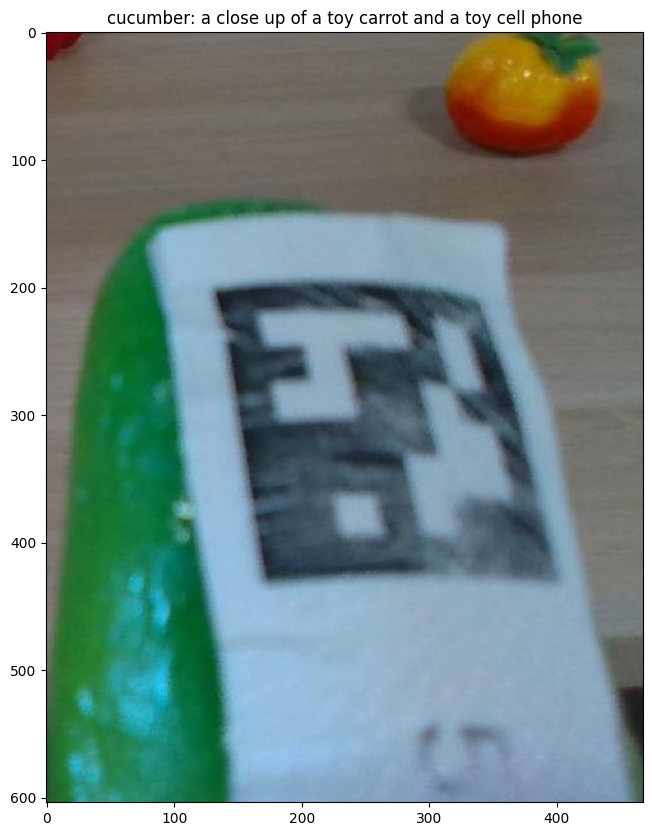

cucumber: a close up of a toy carrot and a toy cell phone
Evaluate text quality [-1, 0, 1]: 
Progress 1303/1402


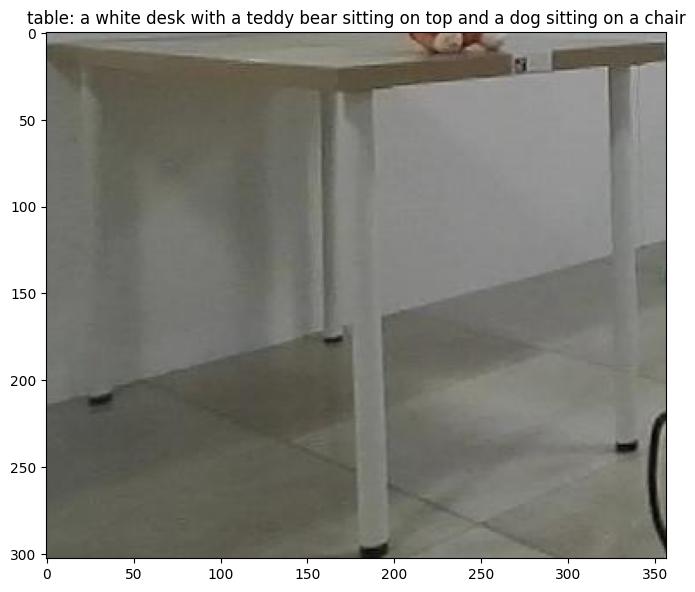

table: a white desk with a teddy bear sitting on top and a dog sitting on a chair
Evaluate text quality [-1, 0, 1]: 0


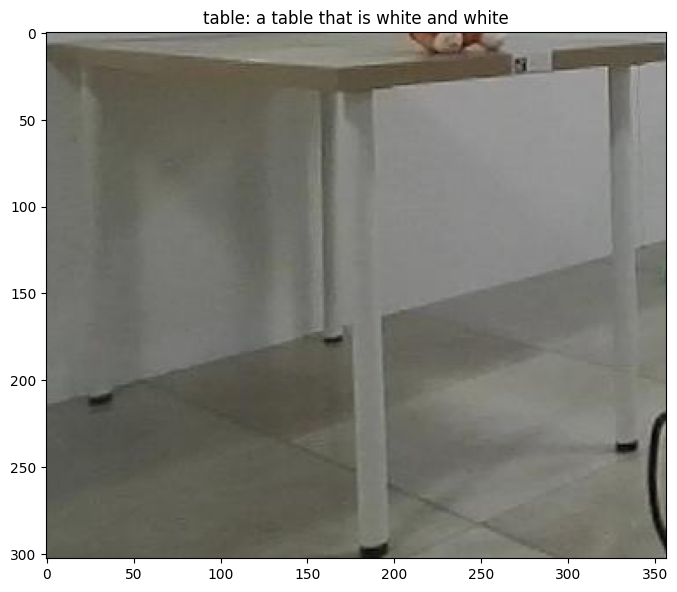

table: a table that is white and white
Evaluate text quality [-1, 0, 1]: 0
Progress 1305/1402


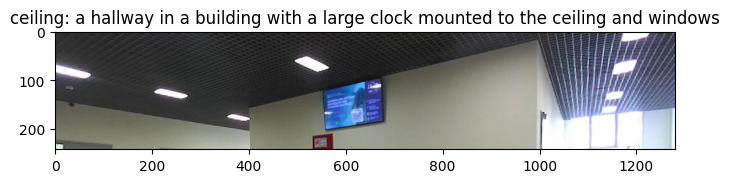

ceiling: a hallway in a building with a large clock mounted to the ceiling and windows
Evaluate text quality [-1, 0, 1]: 


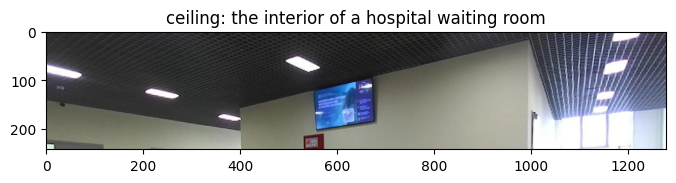

ceiling: the interior of a hospital waiting room
Evaluate text quality [-1, 0, 1]: 
Progress 1308/1402


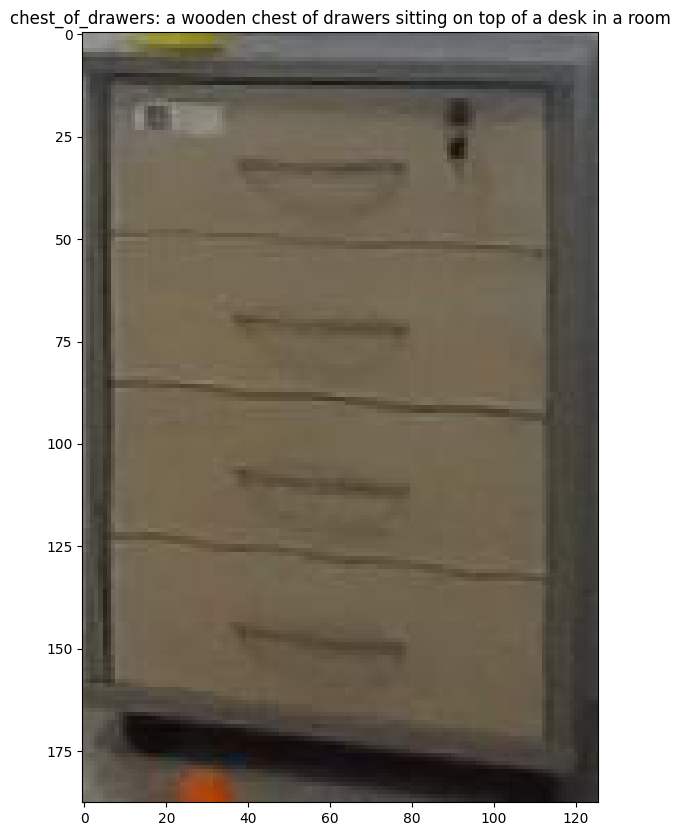

chest_of_drawers: a wooden chest of drawers sitting on top of a desk in a room
Evaluate text quality [-1, 0, 1]: 0


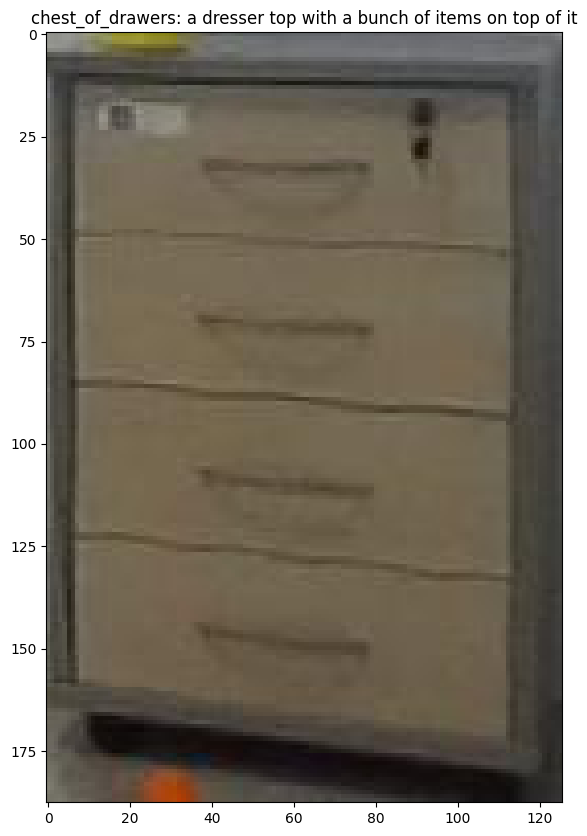

chest_of_drawers: a dresser top with a bunch of items on top of it
Evaluate text quality [-1, 0, 1]: 0
Progress 1310/1402


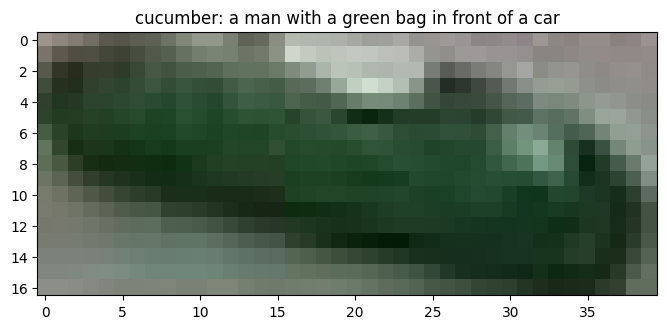

cucumber: a man with a green bag in front of a car
Evaluate text quality [-1, 0, 1]: 


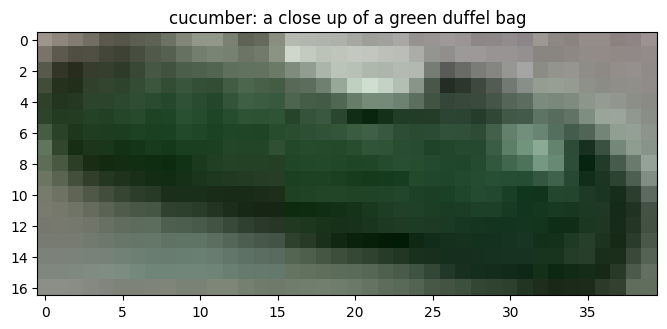

cucumber: a close up of a green duffel bag
Evaluate text quality [-1, 0, 1]: 
Progress 1315/1402


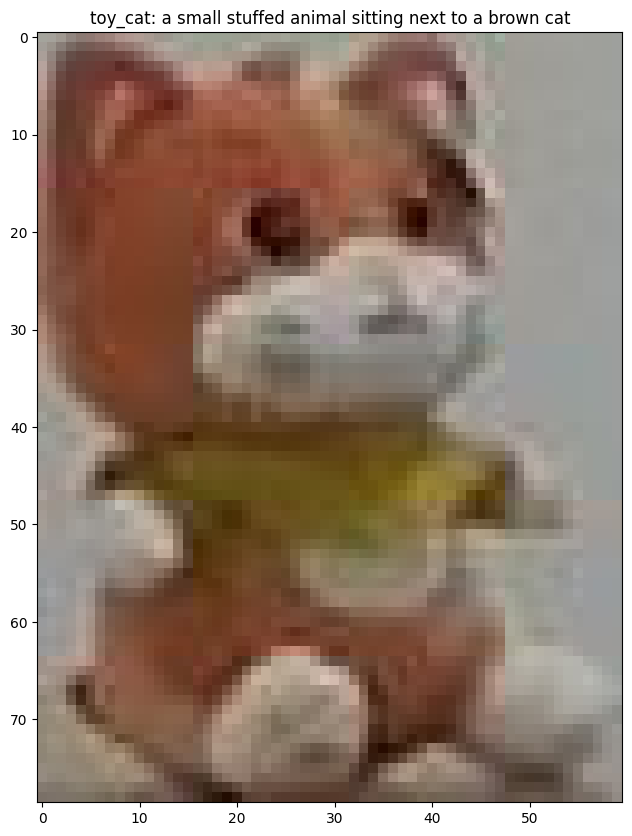

toy_cat: a small stuffed animal sitting next to a brown cat
Evaluate text quality [-1, 0, 1]: 0


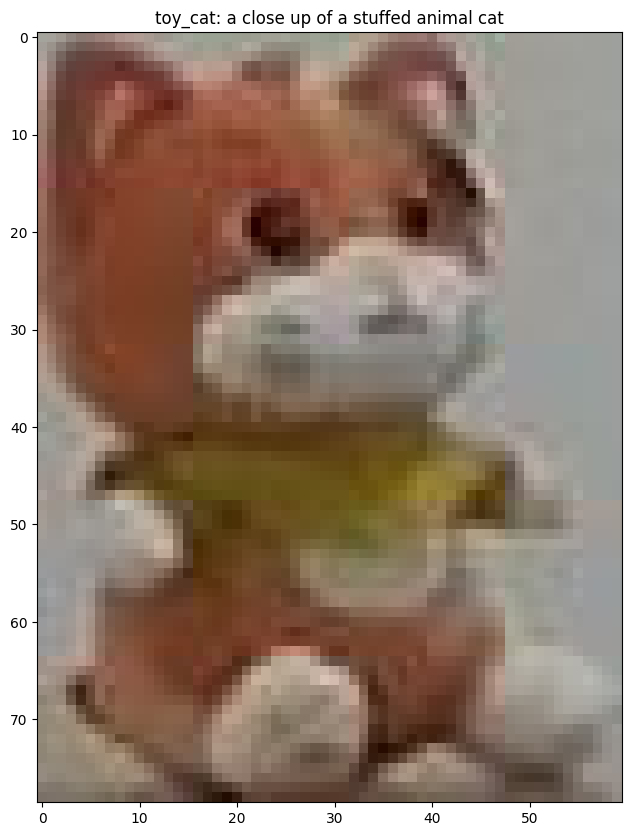

toy_cat: a close up of a stuffed animal cat
Evaluate text quality [-1, 0, 1]: 1
Progress 1316/1402


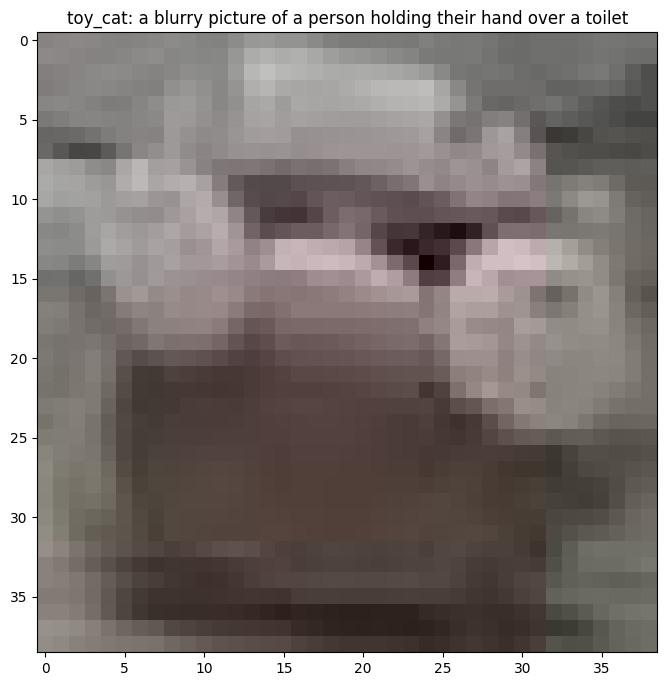

toy_cat: a blurry picture of a person holding their hand over a toilet
Evaluate text quality [-1, 0, 1]: 


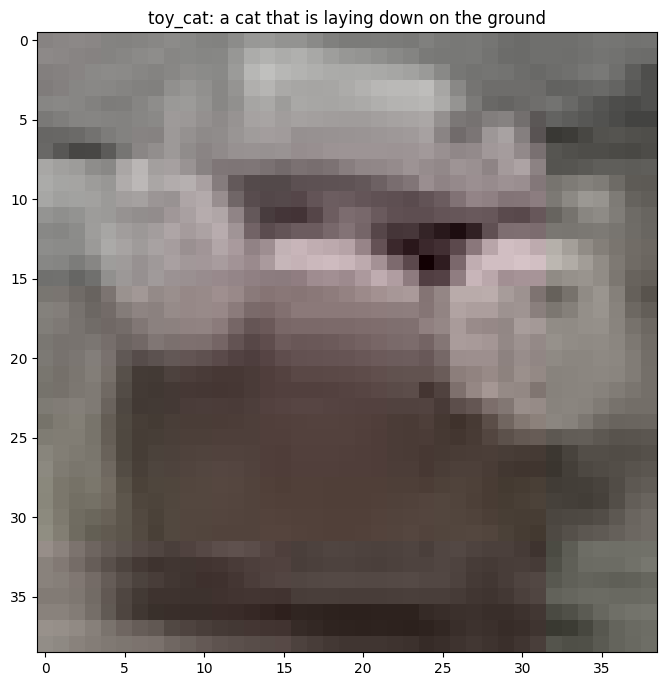

toy_cat: a cat that is laying down on the ground
Evaluate text quality [-1, 0, 1]: 1
Progress 1319/1402


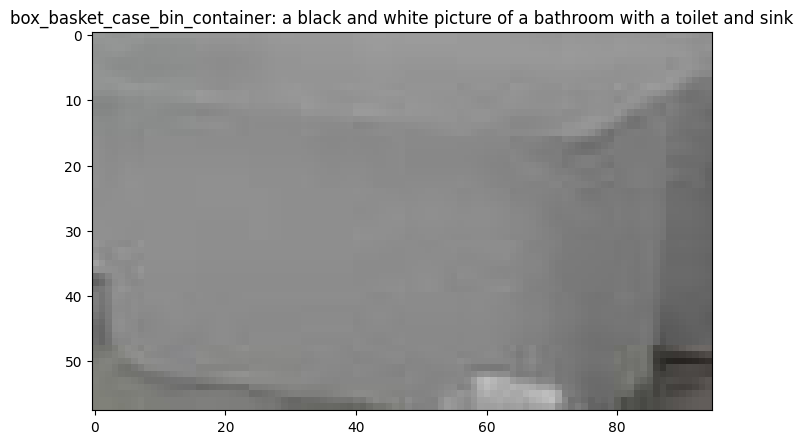

box_basket_case_bin_container: a black and white picture of a bathroom with a toilet and sink
Evaluate text quality [-1, 0, 1]: 


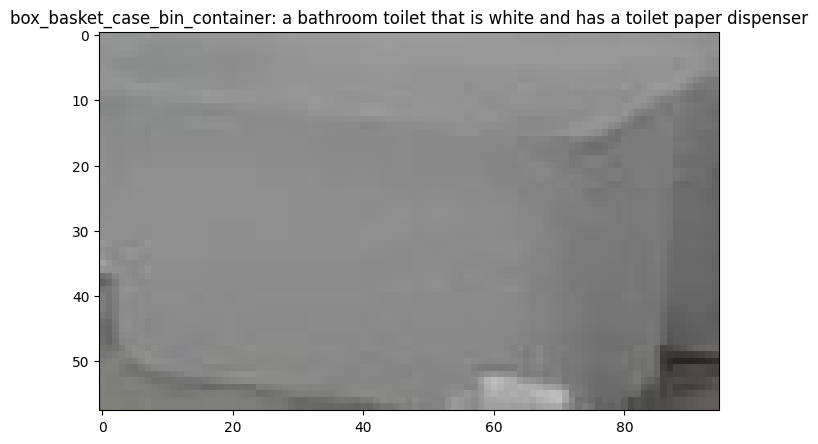

box_basket_case_bin_container: a bathroom toilet that is white and has a toilet paper dispenser
Evaluate text quality [-1, 0, 1]: 
Progress 1329/1402


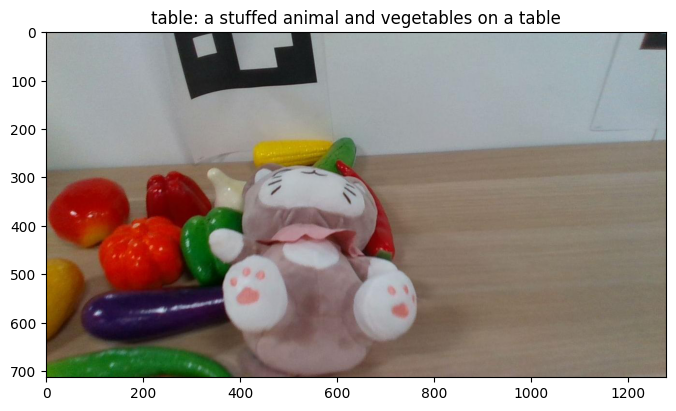

table: a stuffed animal and vegetables on a table
Evaluate text quality [-1, 0, 1]: 0


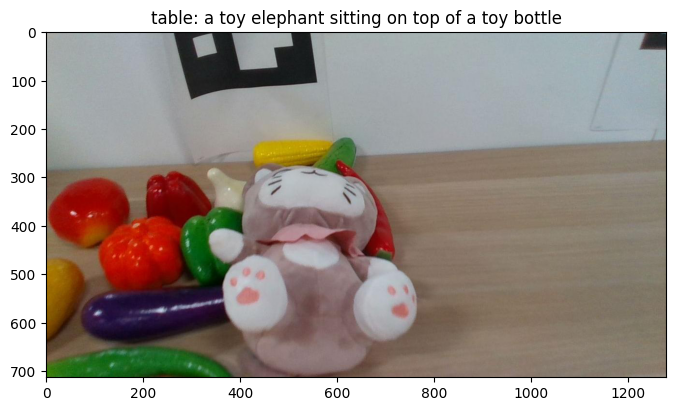

table: a toy elephant sitting on top of a toy bottle
Evaluate text quality [-1, 0, 1]: 
Progress 1332/1402


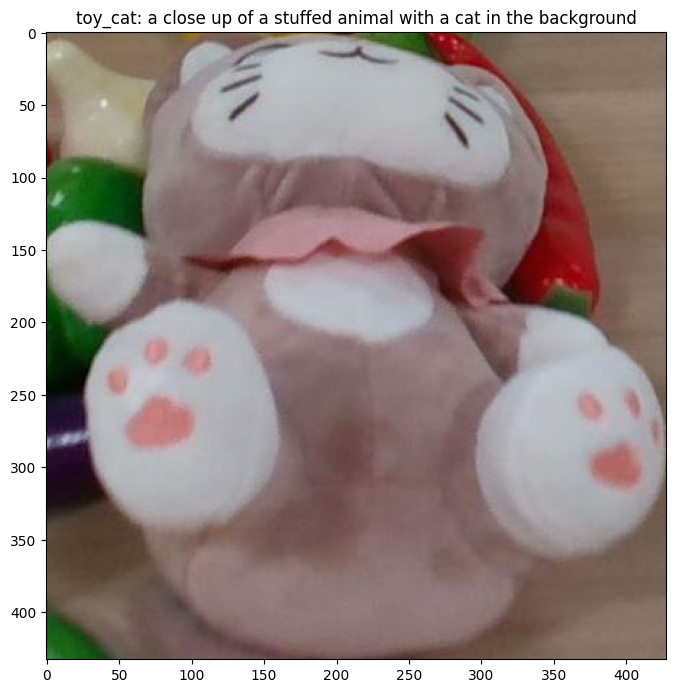

toy_cat: a close up of a stuffed animal with a cat in the background
Evaluate text quality [-1, 0, 1]: 0


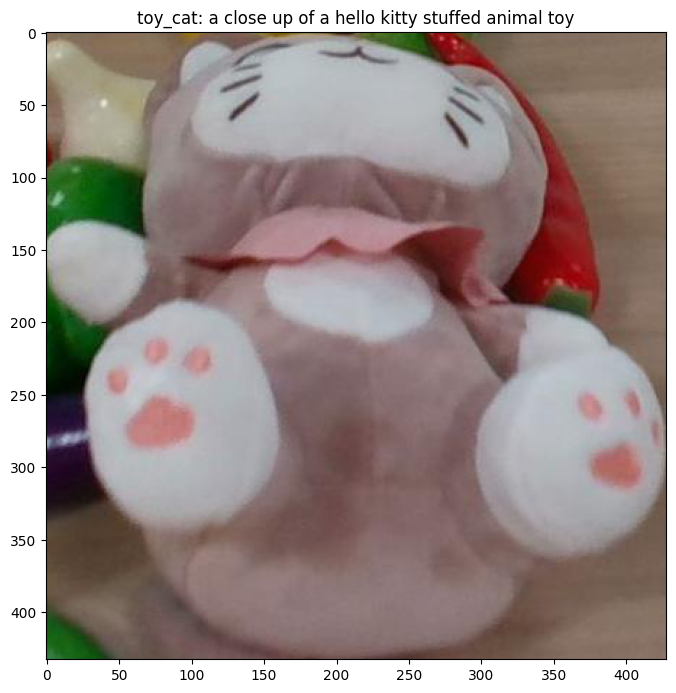

toy_cat: a close up of a hello kitty stuffed animal toy
Evaluate text quality [-1, 0, 1]: 0
Progress 1333/1402


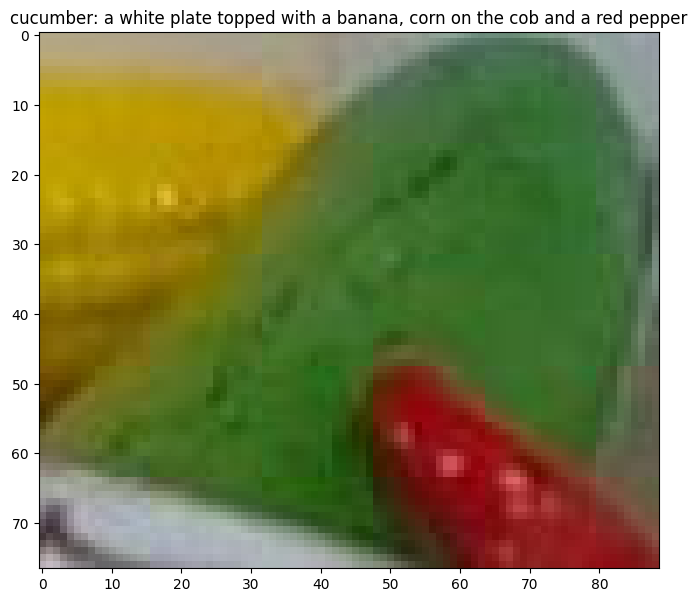

cucumber: a white plate topped with a banana, corn on the cob and a red pepper
Evaluate text quality [-1, 0, 1]: 


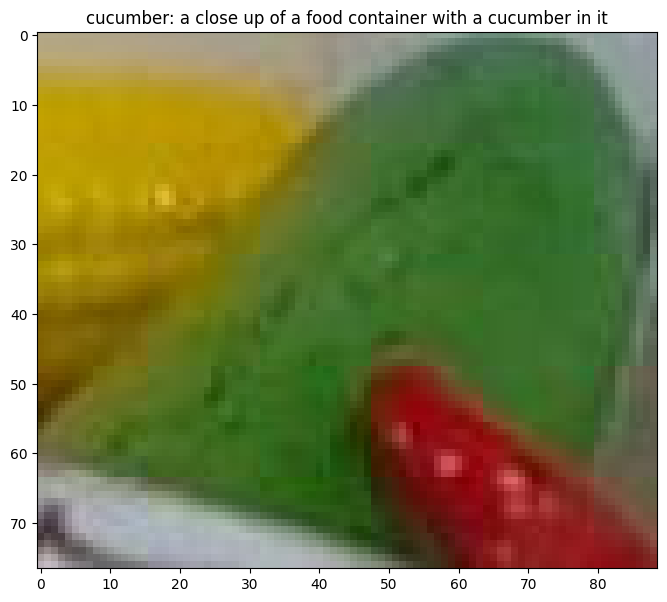

cucumber: a close up of a food container with a cucumber in it
Evaluate text quality [-1, 0, 1]: 0
Progress 1341/1402


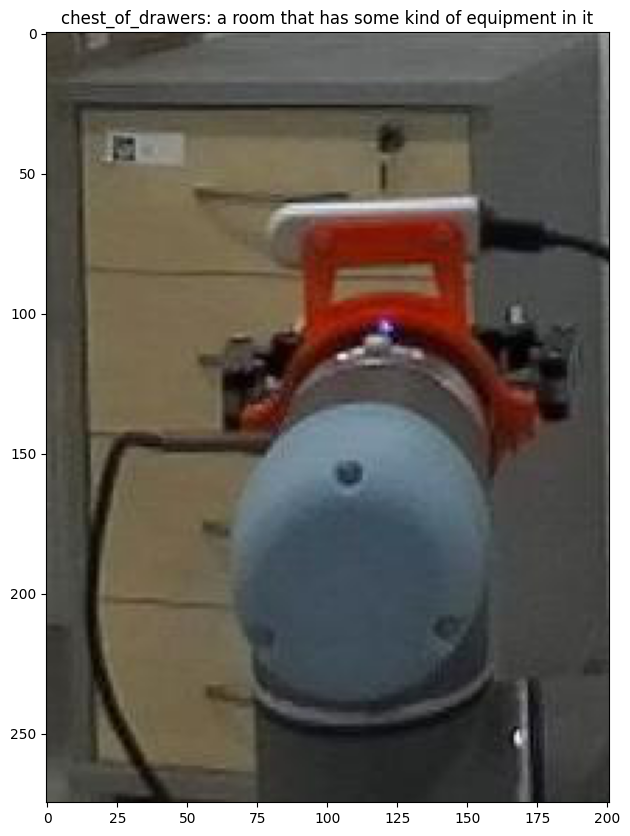

chest_of_drawers: a room that has some kind of equipment in it
Evaluate text quality [-1, 0, 1]: 


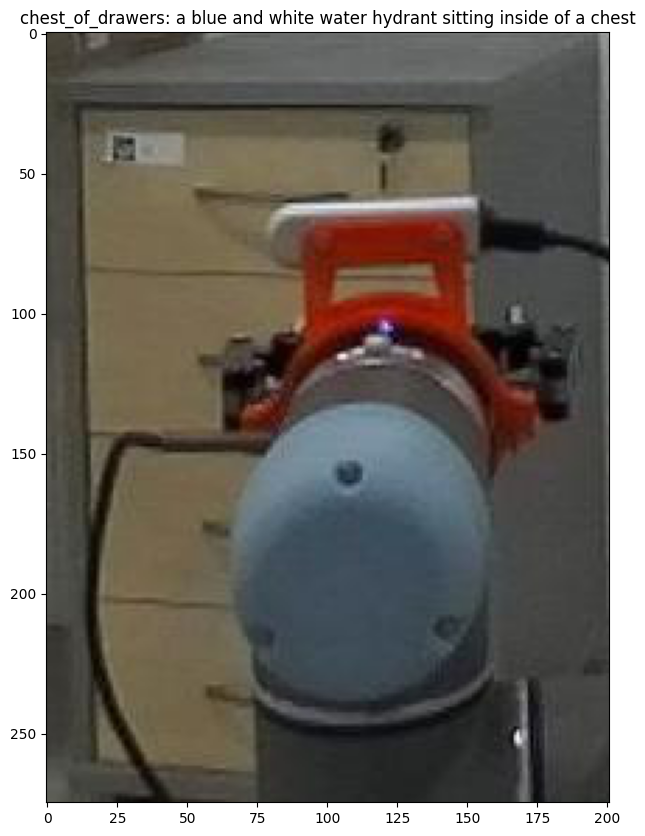

chest_of_drawers: a blue and white water hydrant sitting inside of a chest
Evaluate text quality [-1, 0, 1]: 
Progress 1349/1402


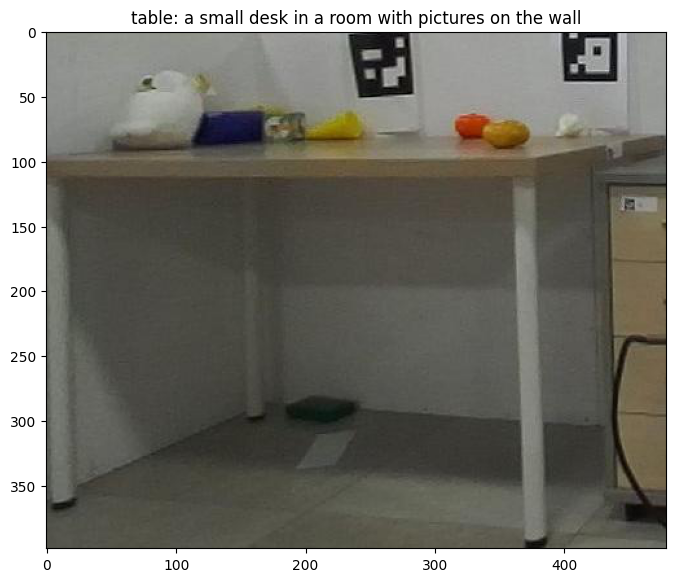

table: a small desk in a room with pictures on the wall
Evaluate text quality [-1, 0, 1]: 0


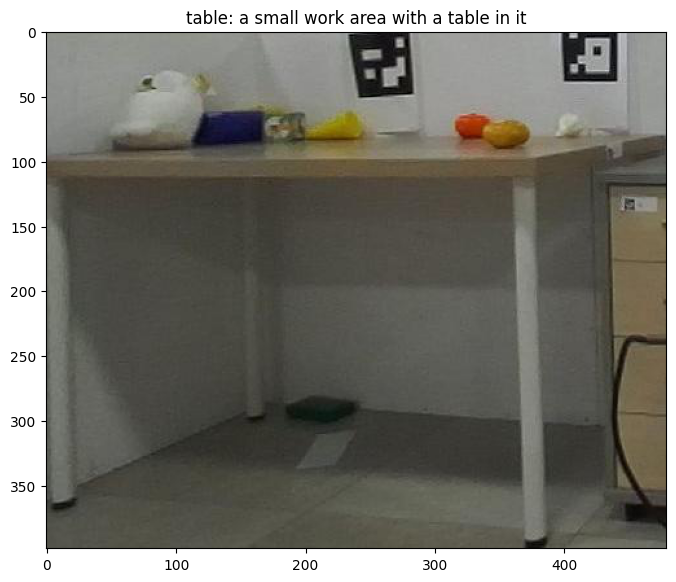

table: a small work area with a table in it
Evaluate text quality [-1, 0, 1]: 0
Progress 1351/1402


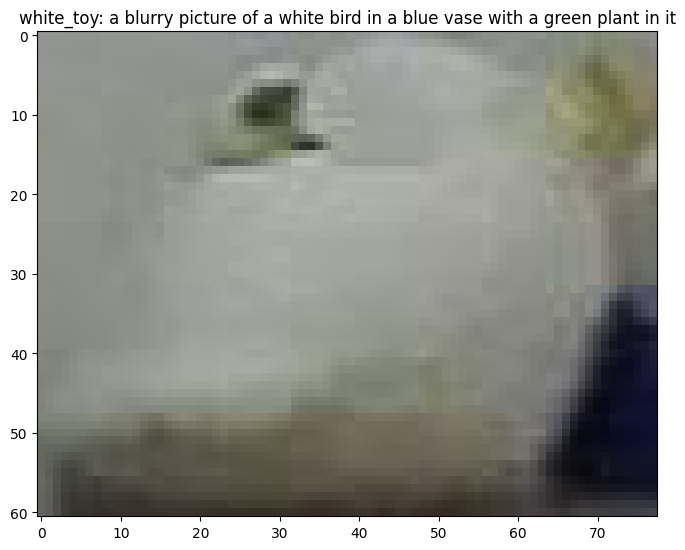

white_toy: a blurry picture of a white bird in a blue vase with a green plant in it
Evaluate text quality [-1, 0, 1]: 


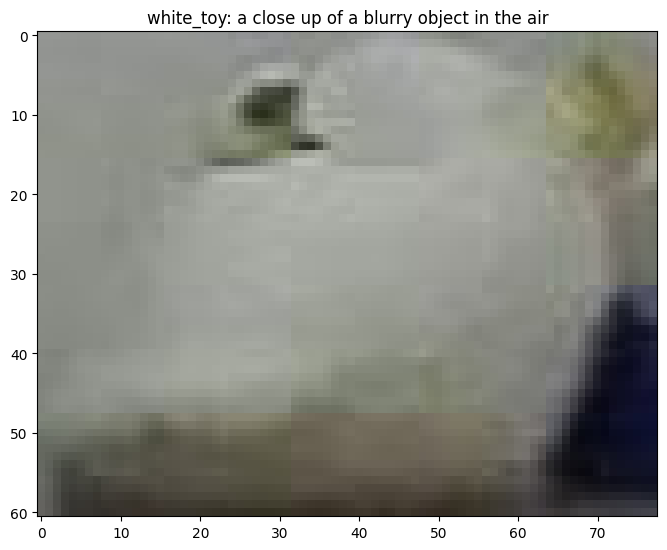

white_toy: a close up of a blurry object in the air
Evaluate text quality [-1, 0, 1]: 
Progress 1352/1402


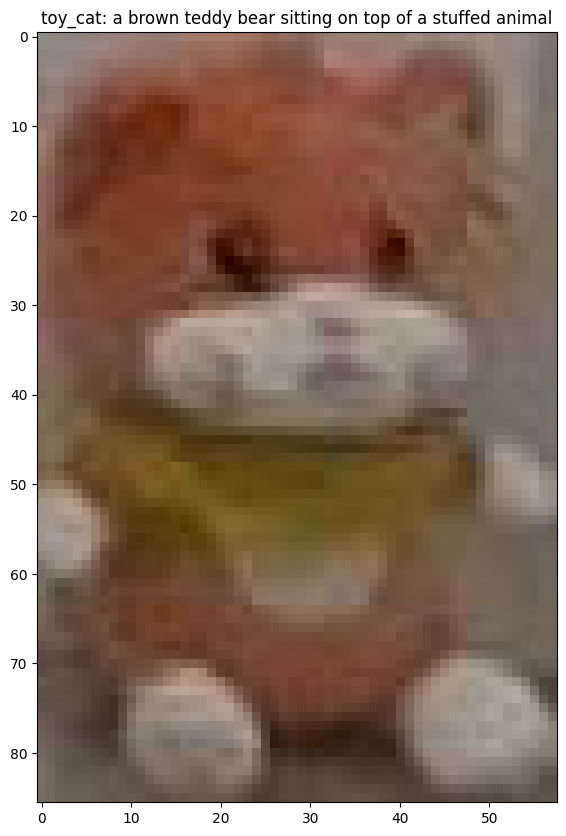

toy_cat: a brown teddy bear sitting on top of a stuffed animal
Evaluate text quality [-1, 0, 1]: 0


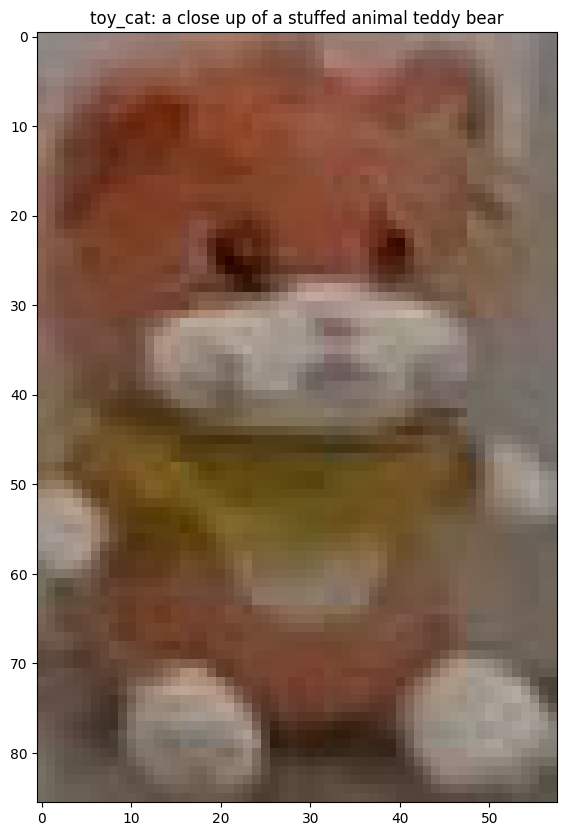

toy_cat: a close up of a stuffed animal teddy bear
Evaluate text quality [-1, 0, 1]: 0
Progress 1364/1402


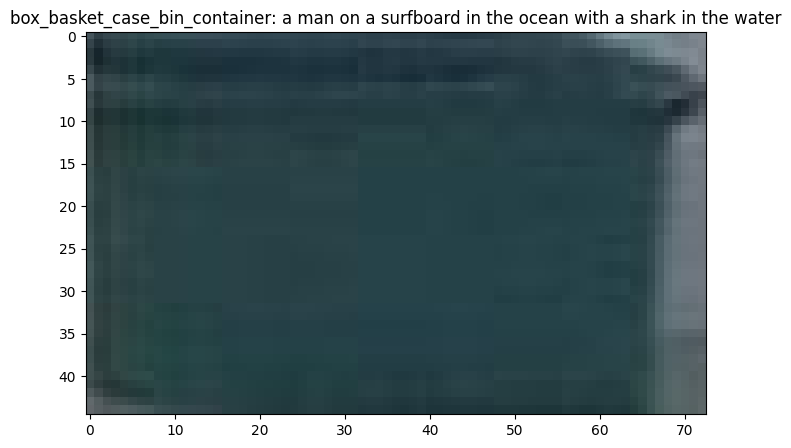

box_basket_case_bin_container: a man on a surfboard in the ocean with a shark in the water
Evaluate text quality [-1, 0, 1]: 


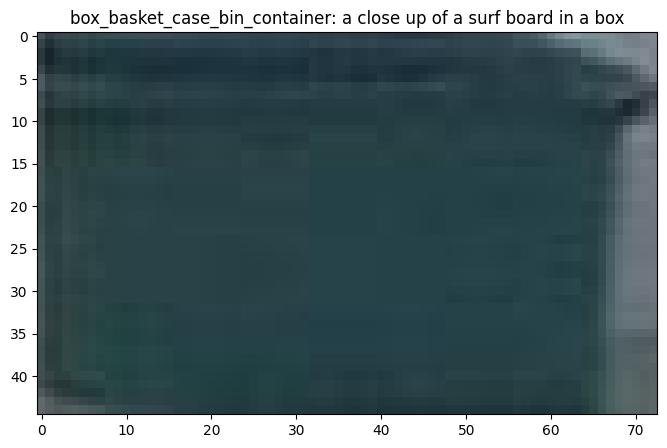

box_basket_case_bin_container: a close up of a surf board in a box
Evaluate text quality [-1, 0, 1]: 
Progress 1365/1402


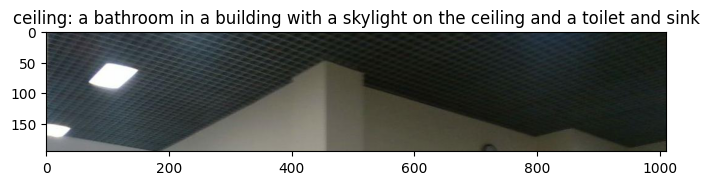

ceiling: a bathroom in a building with a skylight on the ceiling and a toilet and sink
Evaluate text quality [-1, 0, 1]: 


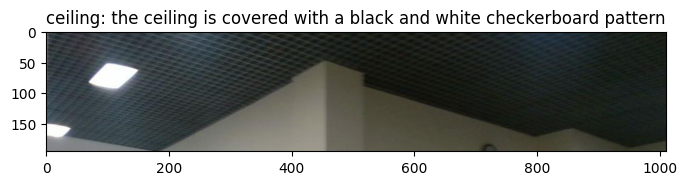

ceiling: the ceiling is covered with a black and white checkerboard pattern
Evaluate text quality [-1, 0, 1]: 0
Progress 1366/1402


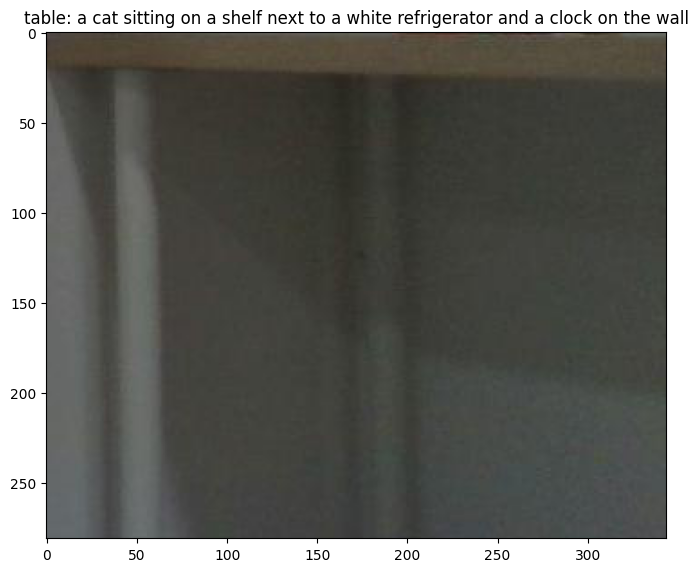

table: a cat sitting on a shelf next to a white refrigerator and a clock on the wall
Evaluate text quality [-1, 0, 1]: 


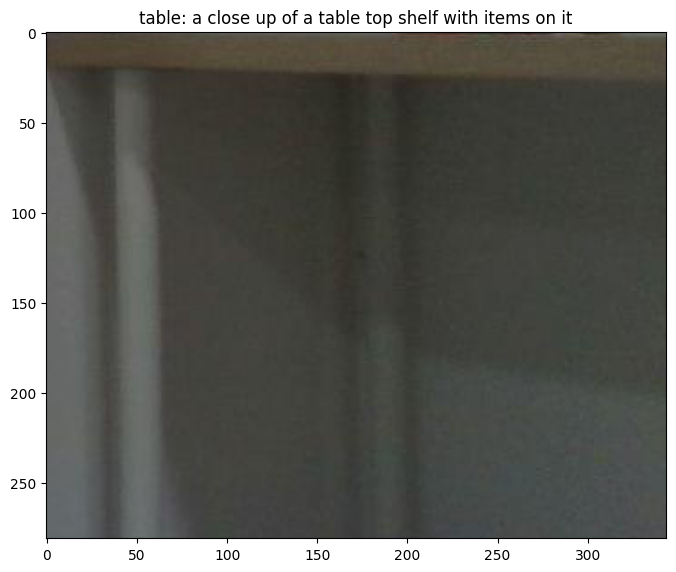

table: a close up of a table top shelf with items on it
Evaluate text quality [-1, 0, 1]: 0
Progress 1374/1402


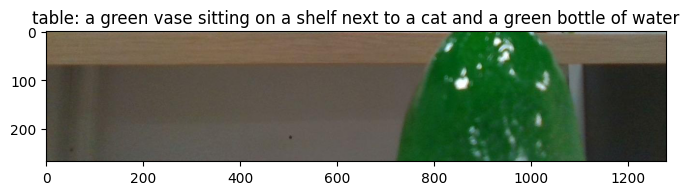

table: a green vase sitting on a shelf next to a cat and a green bottle of water
Evaluate text quality [-1, 0, 1]: 


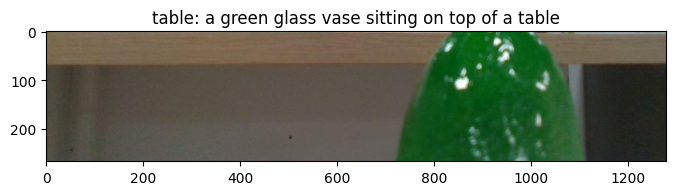

table: a green glass vase sitting on top of a table
Evaluate text quality [-1, 0, 1]: 
Progress 1375/1402


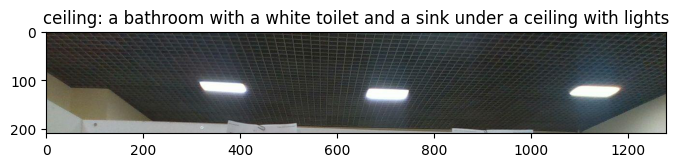

ceiling: a bathroom with a white toilet and a sink under a ceiling with lights
Evaluate text quality [-1, 0, 1]: 


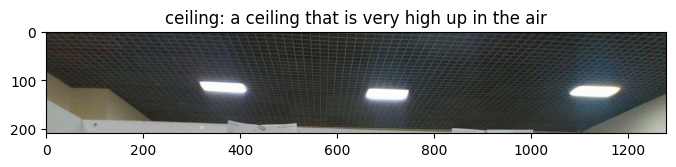

ceiling: a ceiling that is very high up in the air
Evaluate text quality [-1, 0, 1]: 0
Progress 1379/1402


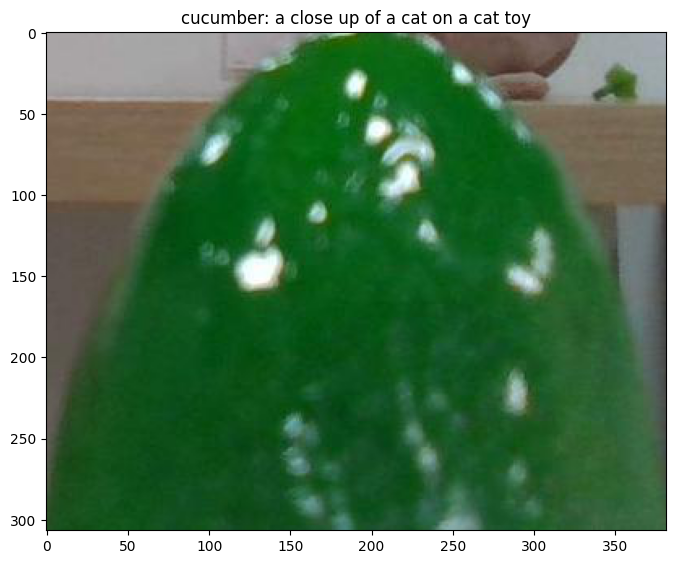

cucumber: a close up of a cat on a cat toy
Evaluate text quality [-1, 0, 1]: 


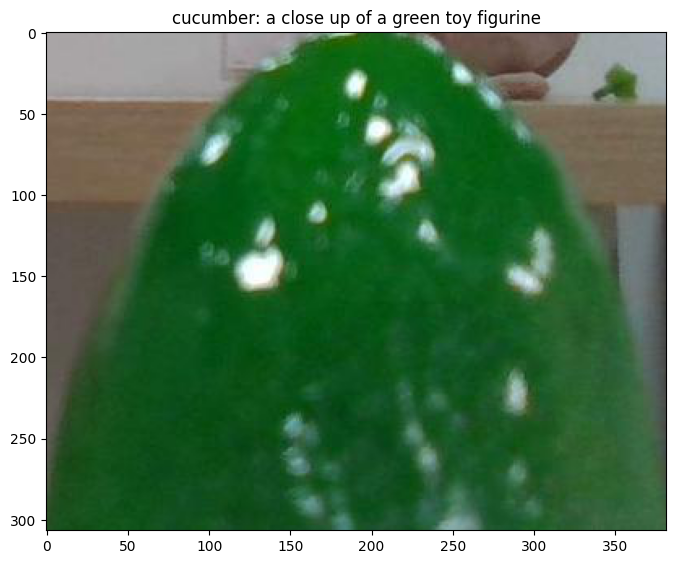

cucumber: a close up of a green toy figurine
Evaluate text quality [-1, 0, 1]: 
Progress 1380/1402


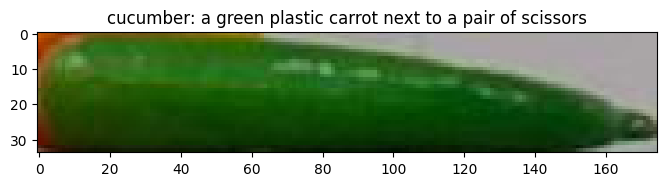

cucumber: a green plastic carrot next to a pair of scissors
Evaluate text quality [-1, 0, 1]: 


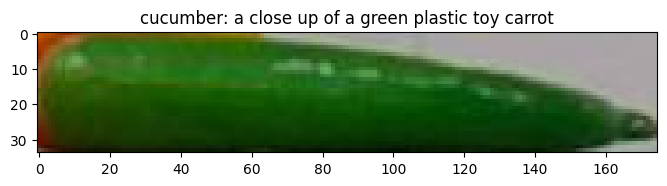

cucumber: a close up of a green plastic toy carrot
Evaluate text quality [-1, 0, 1]: 
Progress 1382/1402


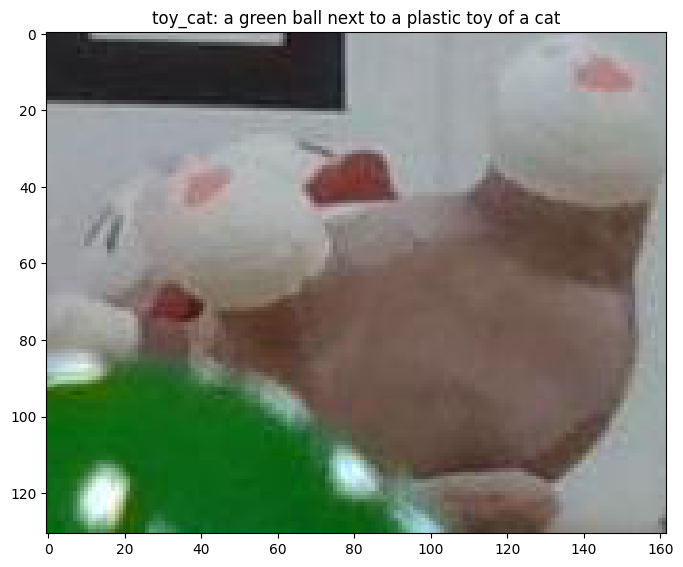

toy_cat: a green ball next to a plastic toy of a cat
Evaluate text quality [-1, 0, 1]: 


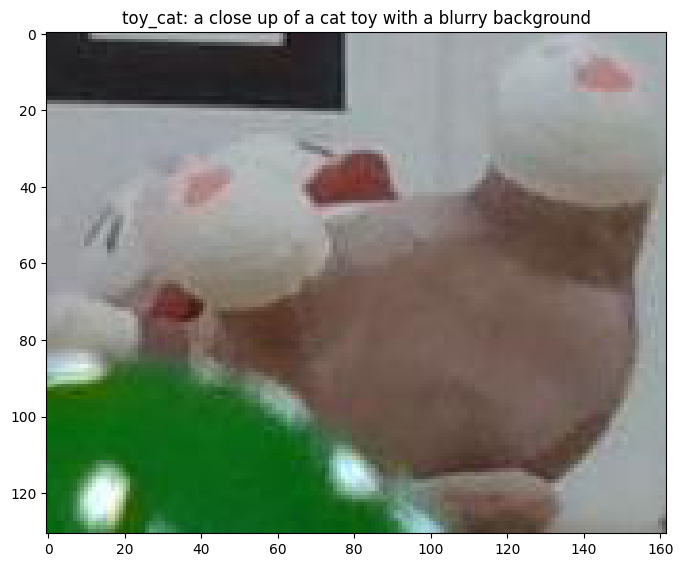

toy_cat: a close up of a cat toy with a blurry background
Evaluate text quality [-1, 0, 1]: 1
Progress 1385/1402


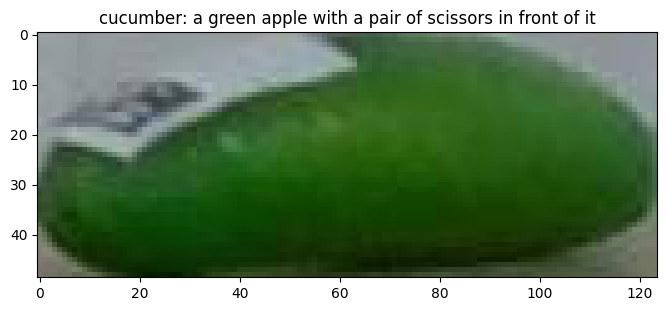

cucumber: a green apple with a pair of scissors in front of it
Evaluate text quality [-1, 0, 1]: 


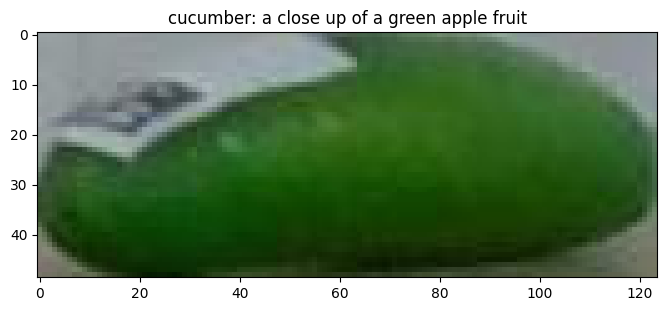

cucumber: a close up of a green apple fruit
Evaluate text quality [-1, 0, 1]: 
Progress 1388/1402


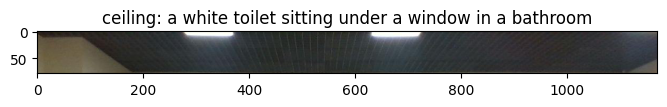

ceiling: a white toilet sitting under a window in a bathroom
Evaluate text quality [-1, 0, 1]: 


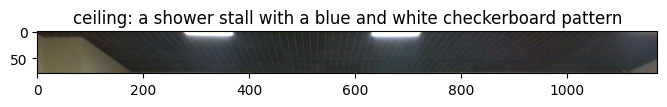

ceiling: a shower stall with a blue and white checkerboard pattern
Evaluate text quality [-1, 0, 1]: 
Progress 1391/1402


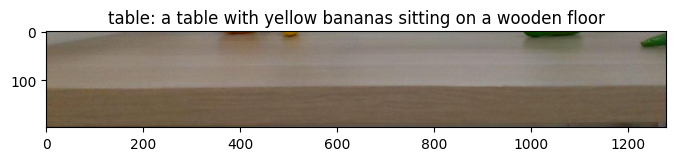

table: a table with yellow bananas sitting on a wooden floor
Evaluate text quality [-1, 0, 1]: 0


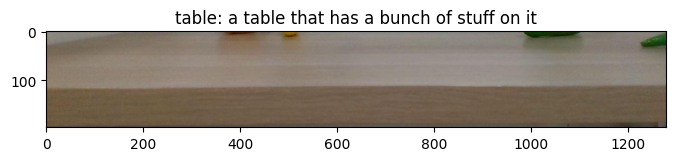

table: a table that has a bunch of stuff on it
Evaluate text quality [-1, 0, 1]: 1
Progress 1395/1402


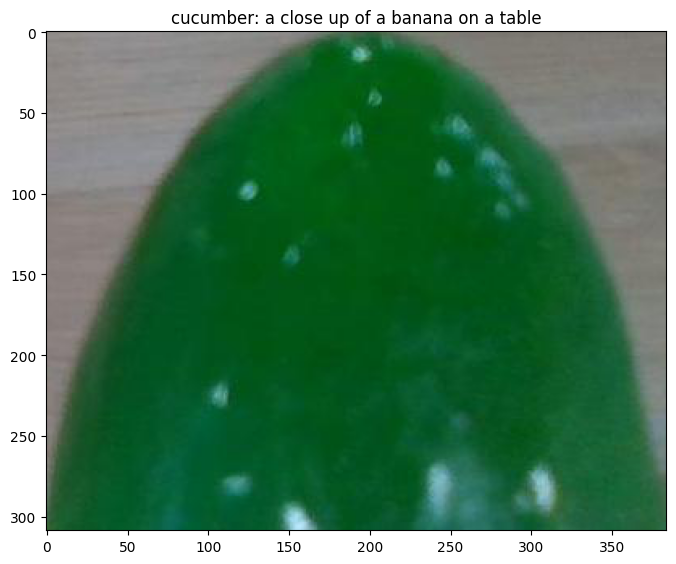

cucumber: a close up of a banana on a table
Evaluate text quality [-1, 0, 1]: 


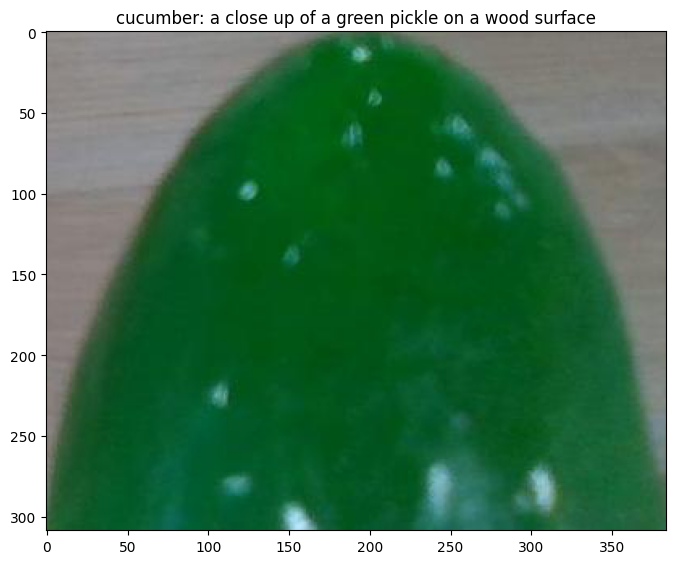

cucumber: a close up of a green pickle on a wood surface
Evaluate text quality [-1, 0, 1]: 1
Progress 1398/1402


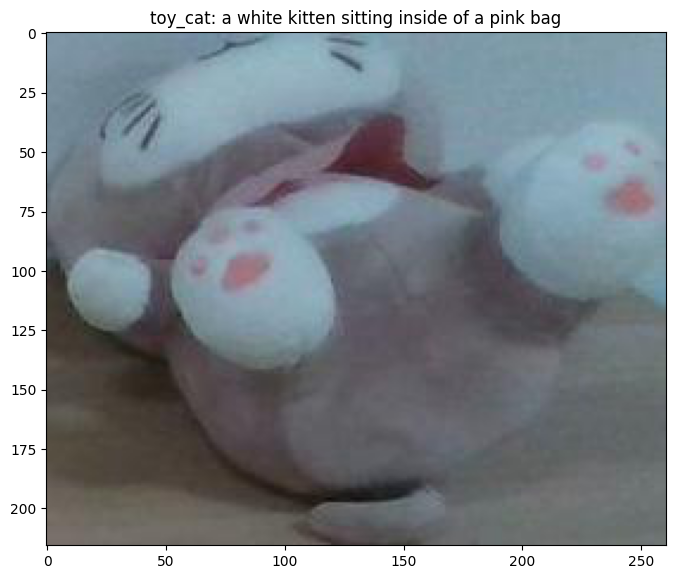

toy_cat: a white kitten sitting inside of a pink bag
Evaluate text quality [-1, 0, 1]: 0


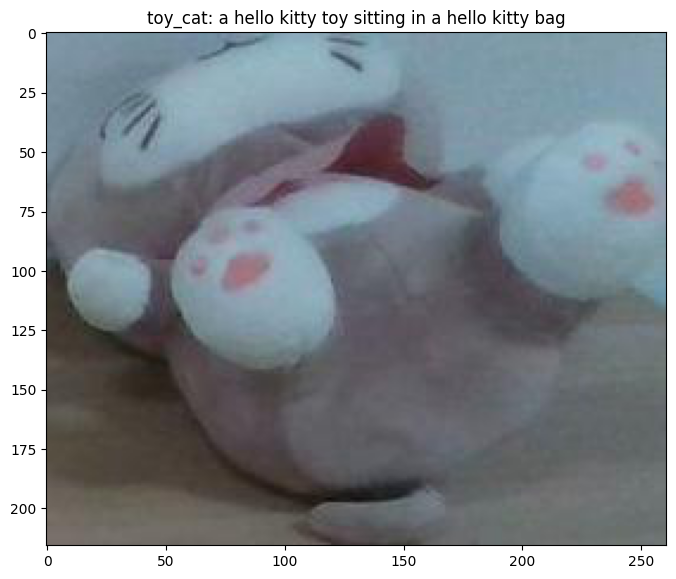

toy_cat: a hello kitty toy sitting in a hello kitty bag
Evaluate text quality [-1, 0, 1]: 0
Progress 1399/1402


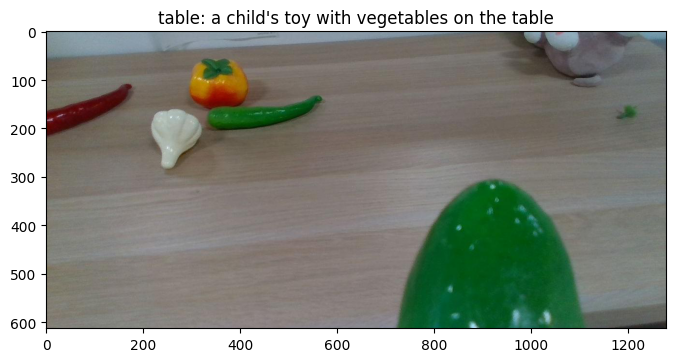

table: a child's toy with vegetables on the table
Evaluate text quality [-1, 0, 1]: 0


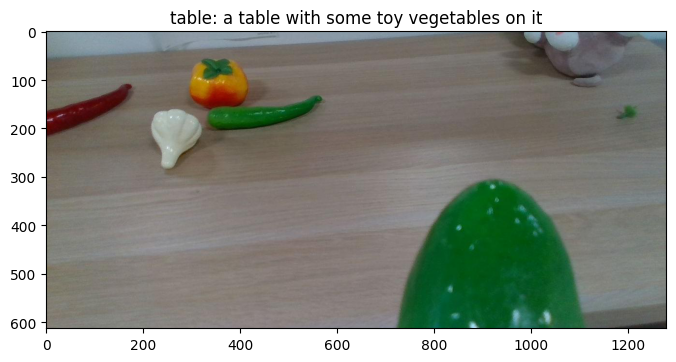

table: a table with some toy vegetables on it
Evaluate text quality [-1, 0, 1]: 1


In [58]:
# 976
coco_annots = "/content/recognize-anything/annot_and_t2t_965.json"
images_dir = "/content/cropped_images"
tags = [
    "tag2text_text",
    "tag2text_text_with_class"
]
output = "annot_t2t_hf.json"

add_human_feedback(coco_annots, images_dir, tags, output, starting_index=976)

In [60]:
# print some statistics
coco_hf = MyCOCO("/content/recognize-anything/annot_t2t_hf.json")

cats = dict()

for i in range(len(coco_hf.anns)):
    annotation = coco_hf.anns[i]
    if "tag2text_text_hf" in annotation.keys():
        cat_id = annotation["category_id"]
        cat_name = coco_hf.cats[cat_id - 1]["name"]
        cats[cat_name] = cats.get(cat_name, 0) + 1

In [62]:
for cat, count in sorted(cats.items()):
    print(f"{cat}: {count}")
total = sum(cats.values())
print(f"Total: {total}")

box_basket_case_bin_container: 28
ceiling: 61
chest_of_drawers: 24
cucumber: 41
person: 10
table: 51
toy_cat: 42
white_toy: 14
Total: 271
